<a href="https://colab.research.google.com/github/distinctkemi/Cardiovascular-Disease-in-NHS-Mid-Essex/blob/main/Cardio_2021.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


#Cardiovascular Disease Project with NHS Essex

## Table of Contents
<ul>
<li><a href="#intro">Introduction</a></li>
<li><a href="#2021">2021 Dataset</a></li>
<li><a href="#risk">Risk Data</a></li>
<li><a href="#mle">Machine Learning Models</a></li>
</ul>

<a id='intro'></a>
## Introduction

Heart disease is one of the top causes of death in the UK, hence it is vital to implement various strategies to decrease the number of deaths caused by this condition. Utilizing data analytic and a data science approach is one of the best methods to accomplish this. This research is crucial in assisting Gp’s and CCG’s in understanding the population at risk of CVD as early as possible, hence reducing the death rate. A thorough data analysis and creating machine learning model will play a significant role in reducing the deaths rate of heart disease.

>  The aim of this project include:

- To understand the current population in Mid and South Essex vulnerable to have cardiovascular disease
- To identify the risk factors related to a stroke and a heart attack that could be used as predictors
- To predict the number of people in Mid and South Essex likely to have a heart attack and the number of people likely to have a stroke in the next 5 years and where they are coming from
- To identify   any   health   inequalities   for our   population with cardiovascular disease and its complications

### Dataset
The [data](https://bit.ly/3AOFIll) used in this study was provided by NHS MID ESSEX and was typically collected from the NHS website dated from 2009 to 2021. This was scraped for five Mid Essex regions: NHS Basildon \& Brentwood, NHS Castle Point and Rochford CCG, NHS Mid Essex CCG, NHS Southend CCG, and NHS Thurrock CCG. The dataset contains seven(7) data sheets:
- 2021 combined data
- Heart trend data
- Risk Trend Data 
- Cardiovascular Disease 1920
- Smoking Trend Data
- Atrial Fibrillation
- Definition of columns



>**Questions that can could be asked from the dataset**
 Which GP has the highest percentage of Coronary Heart Disease patients
- What age group has strong relationship with CHD, Diabetes, heart failure, Stroke and hypertension
- Which GP has the highest number of persons and what is the percentage of CHD in the gp
- What is the correlation between chd and other attributes
- What are the top 5 Gps with a large population?
- What region recorded the highest percentage of chd patients
- What is the trend of cardiovascular disease over the years

# 2021 Dataset
This dataset consist of 148 rowsGeneral practitioners) and 41 attributes, the features of this dataset include:
- `Population`
- `Age groups from 0 - over 95 years`
- `Gender counts: Male and Female`
- `Deprivation Score IMD (2019)`
- `Percentage of people who have a positive experience of their GP practice`
- `Percentage of people reporting good overall experience of making an appointment`
- `Percentage of people reporting to be unemployed`
- `Percentage of people satisfied with practice appointment times`
- `Percentage of people with a long-standing health condition`
- `Number & percentage of patients with Coronary Heart Disease (CHD)`
- `Number & percentage of patients with CHD, a record that aspirin, APT or ACT is taken exists`
- `Number and percentage of patients with a current diagnosis of heart failure due to left ventricular systolic dysfunction (LVSD) who are currently treated with ACE inhibitor or agiotensin receptor blocker (ARB)`
- `Number and percentage of patients with Heart Failure`
- `Last BP reading of patients (<80yrs, with CHD) in last 12mths is <=140/90 (denominator includes PCAs)`
- `Number and percentage of patients with CHD immunised against flu (den.incl.PCAs)`
- `Number & percentage of patients with Chronic Kidney Disease: QOF prevalence (18+)`
- `Number & percentage of patients with diabetes`
- `Number & percentage of smokers`
- `Number & percentage of hypertensive patients`
- `Number & percentage of patients, aged 45+, who have a record of blood pressure (last 5yrs)(denominator incl. PCAs)`
- `Record of offer of support and treatment for smokers (15+, last 24 mnths), denominator incl. PCAs`
- `Smoking status of patients with certain conditions is recorded in last 12 mths , denominator incl. PCAs`
- `Number & percentage of patients with stroke`
- `Number & percentage of patients with obesity`



In [11]:
#Importing libraries
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sb
import numpy as np
import plotly.tools as tls

 
# Machine learning Models
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.preprocessing import LabelEncoder
import plotly.graph_objs as go
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from IPython.display import set_matplotlib_formats
from sklearn.tree import DecisionTreeRegressor
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.express as px
from sklearn.metrics import mean_squared_error, mean_absolute_error
from prophet.plot import plot_plotly


# Code to prevent warning messages
from warnings import simplefilter
simplefilter(action='ignore', category=FutureWarning)

#Feature selection model
from sklearn.feature_selection import RFE
from sklearn.pipeline import Pipeline
from prophet import Prophet
from sklearn.linear_model import Lasso
from prophet.diagnostics import performance_metrics



import plotly.offline as py
py.init_notebook_mode()
%matplotlib inline


In [2]:
#Setting the image quality
sb.set(rc={"figure.dpi":70, 'savefig.dpi':70})
sb.set_context('notebook')
sb.set_style("ticks")
set_matplotlib_formats('retina')
plt.rcParams['figure.dpi'] = 80
plt.rcParams['savefig.dpi'] = 80

In [4]:
#Importing 2021 dataset
df_2021 = pd.read_excel('Cvd data.xlsx', 'Copy of 2021 Combined Data')
df_2021.head()

,CCG Code,CCG Name,GP Code,GP Name,Total Population,0_4,10_14,5_9,15_19,20_24,...,immunised_chd_patients,chronic_kidney_disease_patients,diabetic_patients,smokers,hypertensive_patients,supported_smoker,smokers_with_conditions,obessed_patients,chd_patients,stroke_patients
0,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,1373.0,1859.0,1761.0,1718.0,1402.0,...,624.0,615.0,1619.0,3609.0,3424.0,2181.0,5464.0,885.0,752.0,516.0
1,E38000106,NHS Mid Essex CCG,F81100,Beacon Health Group-Danbury Medical Ctr,25599.0,1176.0,1549.0,1403.0,1485.0,1231.0,...,592.0,652.0,1266.0,2267.0,3717.0,2089.0,5501.0,815.0,685.0,466.0
2,E38000030,NHS Southend CCG,F81123,Audley Mills Surgery,20685.0,956.0,1264.0,1184.0,1144.0,919.0,...,549.0,352.0,1052.0,1863.0,2953.0,1462.0,4251.0,708.0,671.0,448.0
3,E38000030,NHS Southend CCG,F81007,"Dr Puzey,Dr Kothari and Dr Nanda",20774.0,991.0,1280.0,1178.0,1148.0,1123.0,...,543.0,461.0,1236.0,2659.0,3135.0,1590.0,4712.0,988.0,668.0,355.0
4,E38000168,NHS Southend CCG,F81081,Queensway Medical Centre,20209.0,1025.0,1278.0,1181.0,1099.0,1189.0,...,459.0,758.0,1214.0,3911.0,2952.0,2457.0,4188.0,756.0,662.0,363.0


In [ ]:
#Checking for size of the dataset(number of rows and columns)
df_2021.shape

(150, 48)

In [5]:
#Checking rows with missing values 
df_2021.isna().sum()

CCG Code                                            0
CCG Name                                            0
GP Code                                             0
GP Name                                             0
Total Population                                    2
0_4                                                 2
10_14                                               2
5_9                                                 2
15_19                                               2
20_24                                               2
25_29                                               2
30_34                                               2
35_39                                               2
40_44                                               2
45_49                                               2
50_54                                               2
55_59                                               2
60_64                                               2
65_69                       

> There are two missing in some columns from the resullt above, and one of the important column which is the total population has missing rows, so we will be deleting these two rows.


In [12]:
#Checking for duplicates in the dataset
df_2021.duplicated().sum()

0

> The result above shows that there are no duplicated rows in the data



In [6]:
#Checking the information about the dataset including the data types of each column
df_2021.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 48 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   CCG Code                                          150 non-null    object 
 1   CCG Name                                          150 non-null    object 
 2   GP Code                                           150 non-null    object 
 3   GP Name                                           150 non-null    object 
 4   Total Population                                  148 non-null    float64
 5   0_4                                               148 non-null    float64
 6   10_14                                             148 non-null    float64
 7   5_9                                               148 non-null    float64
 8   15_19                                             148 non-null    float64
 9   20_24                

> All columns are in right data type

In [ ]:
#Statistics summary of the data
df_2021.describe().T

,count,mean,std,min,25%,50%,75%,max
Total Population,148.0,8497.918919,5165.366851,2218.000000,4596.000000,6899.000000,12185.500000,28135.000000
0_4,148.0,451.905405,279.597849,94.000000,237.500000,382.500000,602.000000,1373.000000
10_14,148.0,529.979730,334.174879,120.000000,271.000000,435.000000,720.500000,1859.000000
5_9,148.0,515.851351,319.685631,100.000000,261.750000,429.500000,705.500000,1761.000000
15_19,148.0,478.939189,305.504806,87.000000,243.500000,394.000000,657.250000,1718.000000
20_24,148.0,428.209459,263.856879,84.000000,228.750000,343.000000,599.750000,1402.000000
25_29,148.0,509.000000,315.942731,109.000000,269.000000,400.000000,692.500000,1664.000000
30_34,148.0,585.047297,371.417130,146.000000,306.000000,445.000000,767.250000,1879.000000
35_39,148.0,589.074324,372.020592,147.000000,302.750000,461.000000,816.000000,1950.000000
40_44,148.0,569.817568,362.515250,127.000000,297.750000,454.500000,809.500000,2022.000000


The really high values of the standard deviation for the majority of the columns are the most noticeable number from the aforementioned summary statistics. We can also speculate that there are outliers from the large difference between the minimum and maximum values.

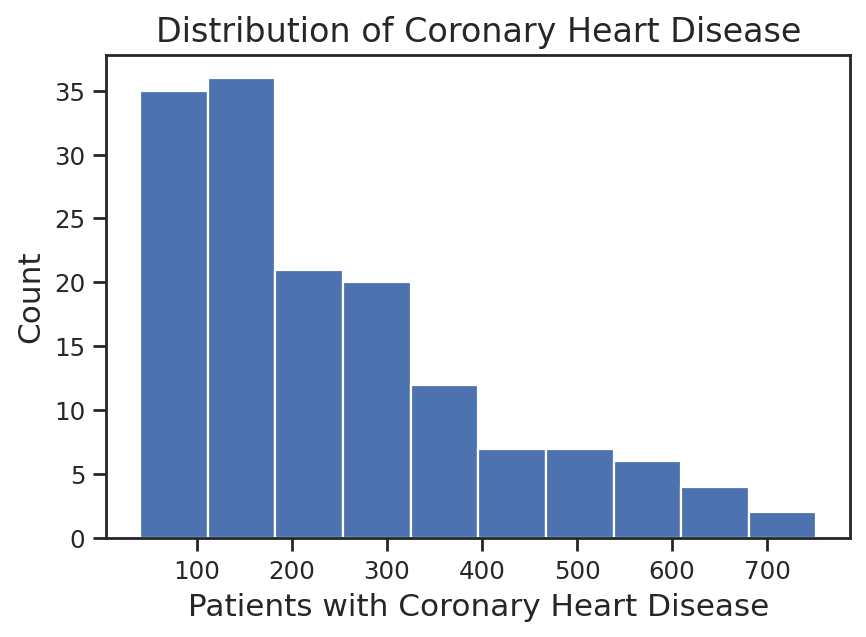

In [ ]:
#Distribution of number of patients with coronary heart disease

plt.hist(data = df_2021, x = 'chd_patients');
plt.title('Distribution of Coronary Heart Disease', fontsize=15)
plt.xlabel('Patients with Coronary Heart Disease', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.show()


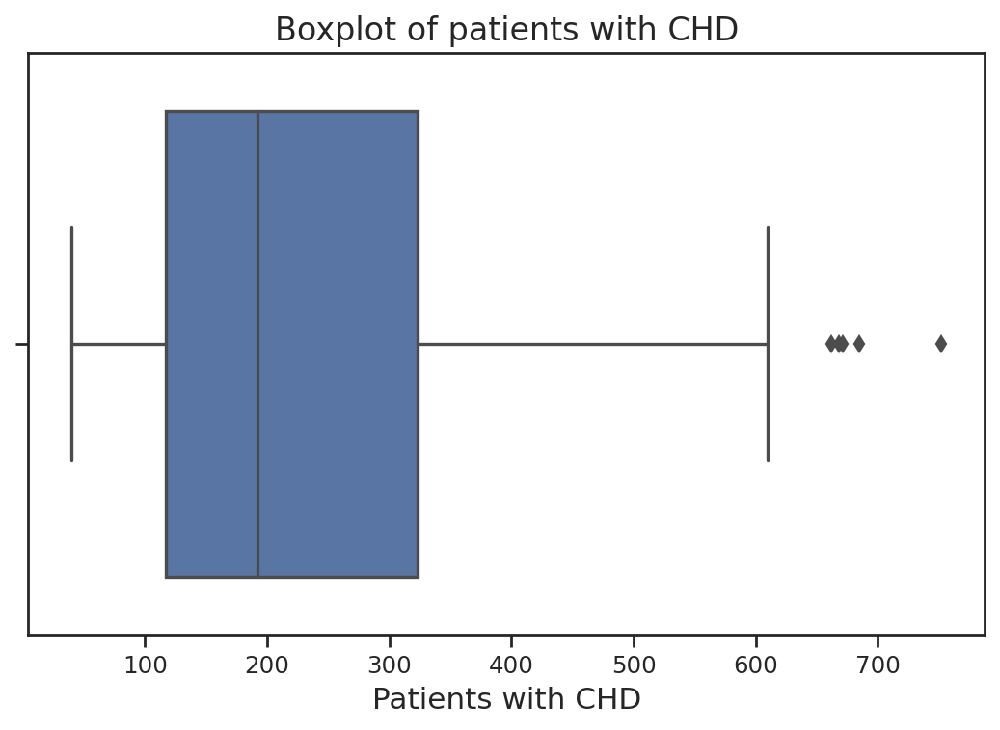

In [10]:
#Visualising the Chd column with boxplot to check for outliers
fig = plt.figure(figsize=(8,5))
sb.boxplot(df_2021['chd_patients'])
plt.title('Boxplot of patients with CHD', fontsize=15)
plt.xlabel('Patients with CHD', fontsize=14)
plt.show();

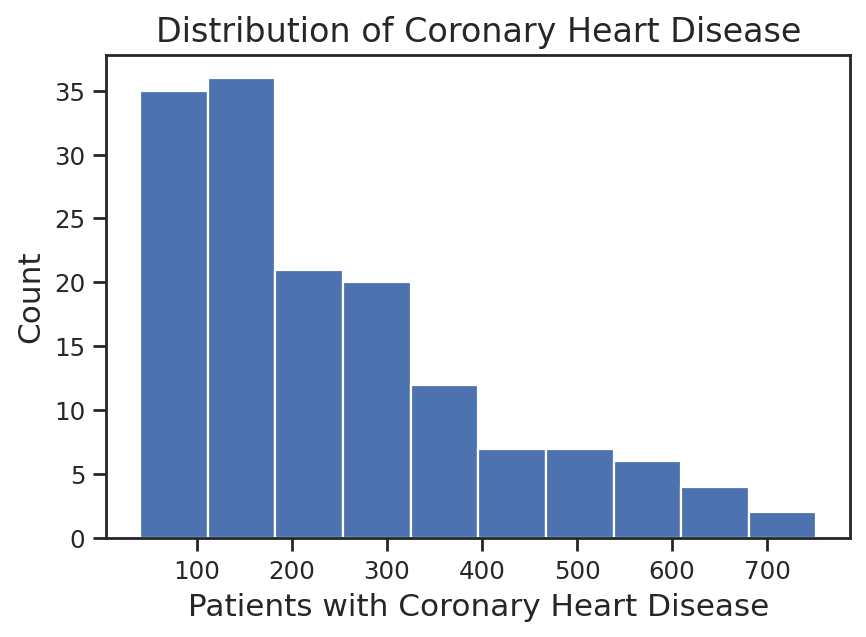

In [9]:
#Distribution of number of patients with coronary heart disease

plt.hist(data = df_2021, x = 'chd_patients');
plt.title('Distribution of Coronary Heart Disease', fontsize=15)
plt.xlabel('Patients with Coronary Heart Disease', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.show()

> The plot above shows that the chd column is skew to the right

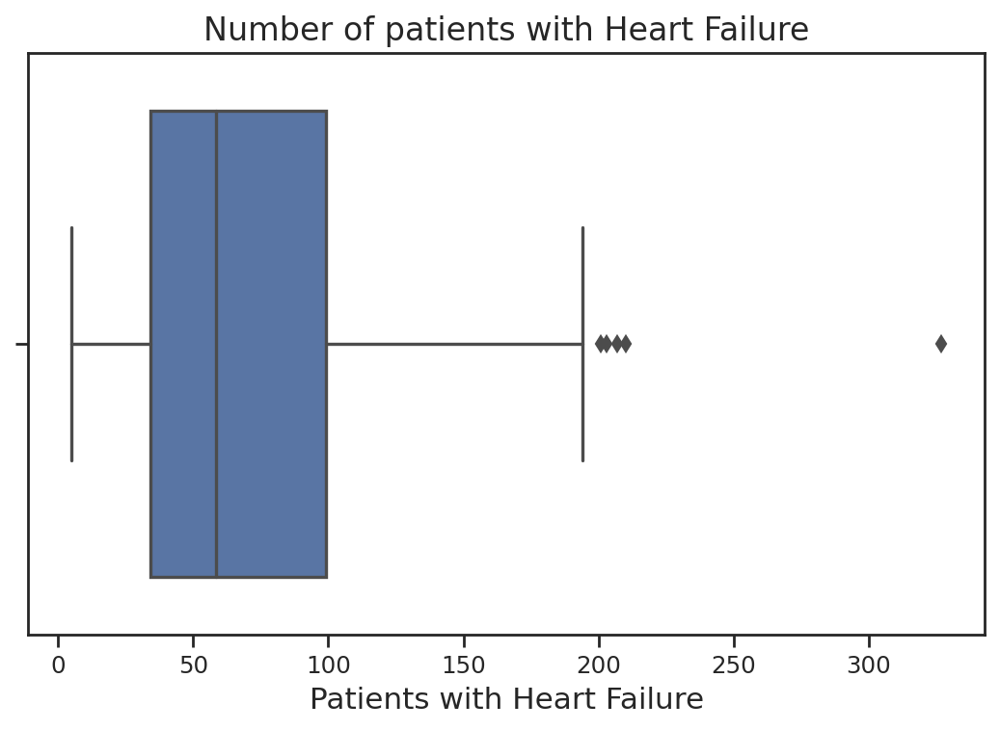

<Figure size 480x320 with 0 Axes>

In [7]:
#Visualising the Chd column with boxplot to check for outliers
fig = plt.figure(figsize=(8,5))
sb.boxplot(df_2021['heart_failure_patients'])
plt.title('Number of patients with Heart Failure', fontsize=15)
plt.xlabel('Patients with Heart Failure', fontsize=14)
plt.show()
plt.savefig('chd patients');

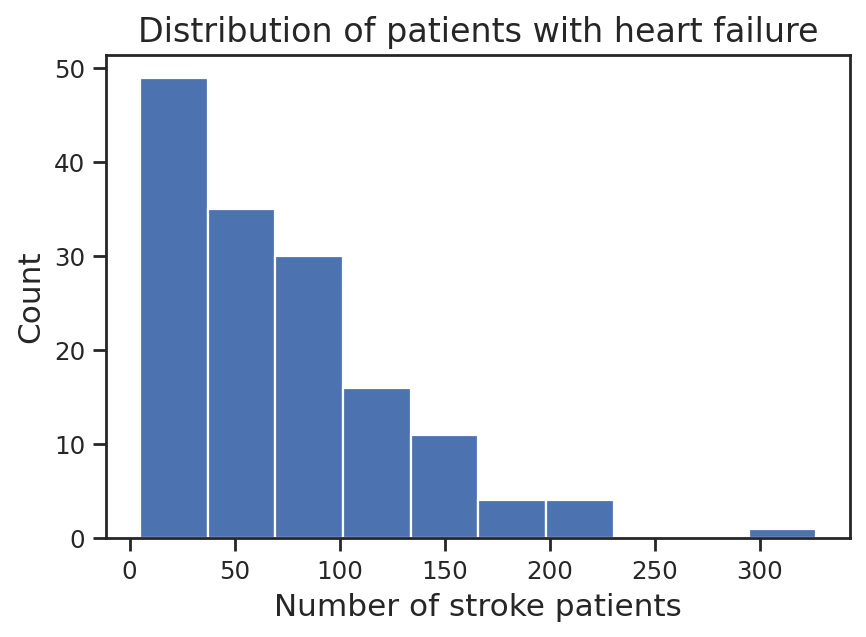

In [8]:
#Distribution of percentage of patients with stroke

plt.hist(data = df_2021, x = 'heart_failure_patients');
plt.title('Distribution of patients with heart failure', fontsize=15)
plt.xlabel('Number of stroke patients', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.show()


> As speculated from the statistics summary, the box plot above shows that there are outliers in the chd patients column 

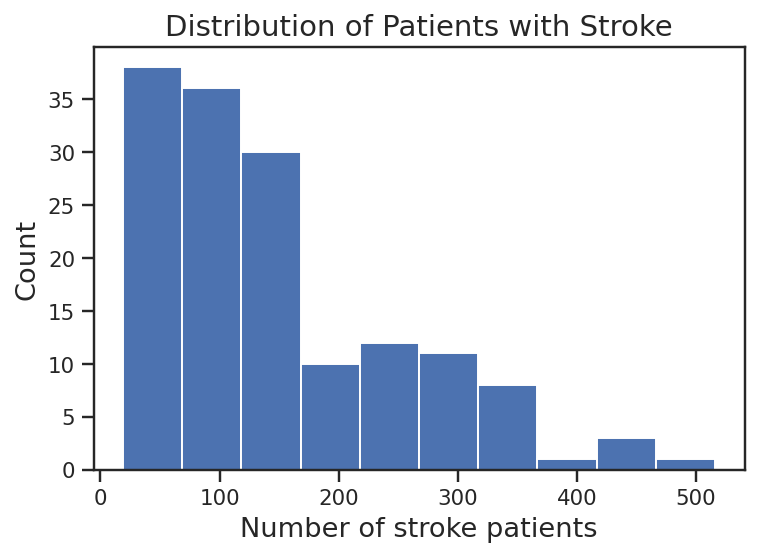

In [ ]:
#Distribution of percentage of patients with stroke

plt.hist(data = df_2021, x = 'stroke_patients');
plt.title('Distribution of Patients with Stroke', fontsize=15)
plt.xlabel('Number of stroke patients', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.show()


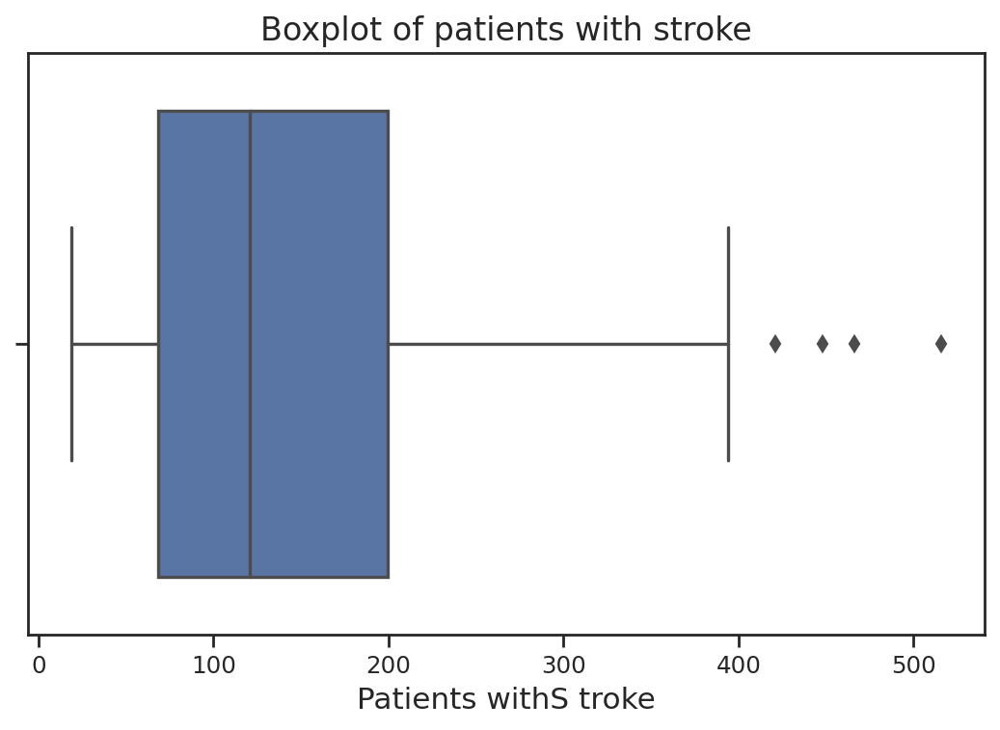

<Figure size 480x320 with 0 Axes>

In [ ]:
#Visualising the Chd column with boxplot to check for outliers
fig = plt.figure(figsize=(8,5))
sb.boxplot(df_2021['stroke_patients'])
plt.title('Boxplot of patients with stroke', fontsize=15)
plt.xlabel('Patients withS troke', fontsize=14)
plt.show()
plt.savefig('chd patients');

In [ ]:
#Skewness of all the columns
df_2021.skew()

Total Population                                    1.149965
0_4                                                 1.012585
10_14                                               1.251905
5_9                                                 1.147481
15_19                                               1.337471
20_24                                               1.177809
25_29                                               1.197899
30_34                                               1.117805
35_39                                               1.147185
40_44                                               1.269182
45_49                                               1.282397
50_54                                               1.276813
55_59                                               1.158521
60_64                                               1.124050
65_69                                               1.141614
70_74                                               1.087262
75_79                   

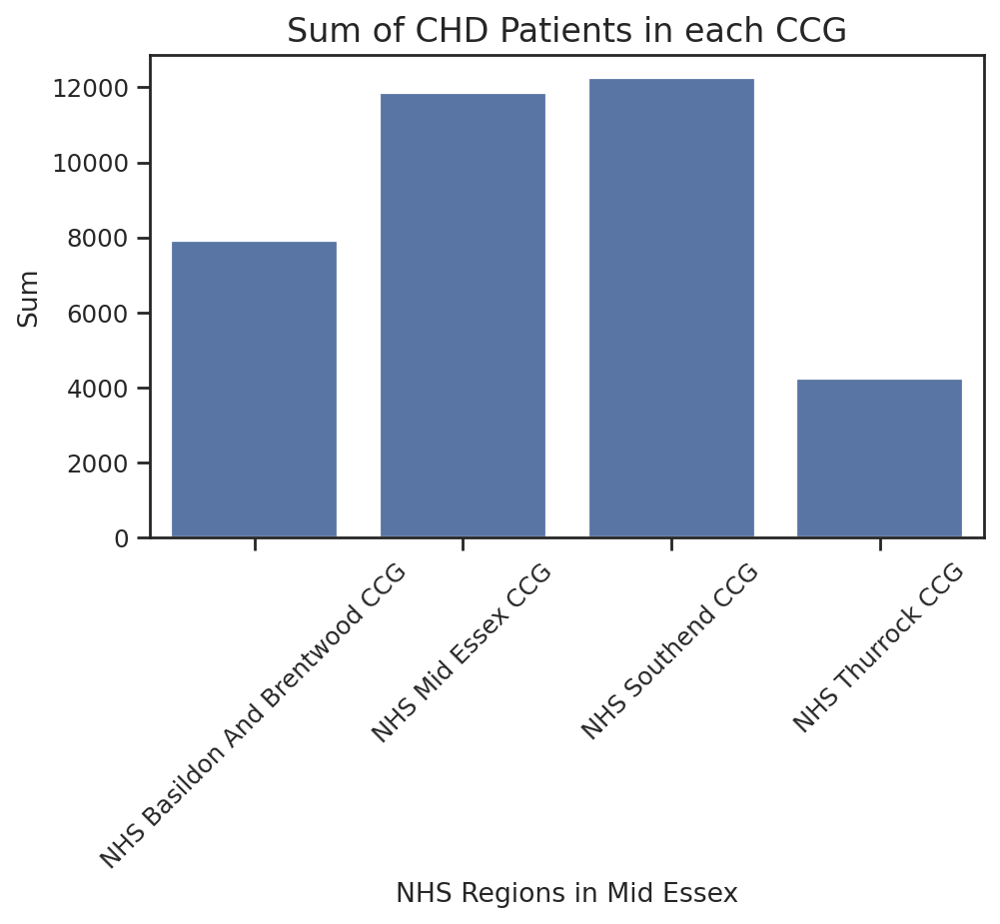

In [ ]:
#Histogram plot of sum of chd patients in eacH CCG
b= pd.DataFrame(df_2021.groupby('CCG Name')['chd_patients'].sum())
b.reset_index(inplace = True)
base_color = sb.color_palette()[0]
sb.barplot(x='CCG Name', y='chd_patients', data=b, color = base_color)
plt.xticks(rotation =45)
plt.title('Sum of CHD Patients in each CCG', fontsize=15)
plt.xlabel('NHS Regions in Mid Essex')
plt.ylabel('Sum');

<ipython-input-237-09d02235d65e>:6: MatplotlibDeprecationWarning:

Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.



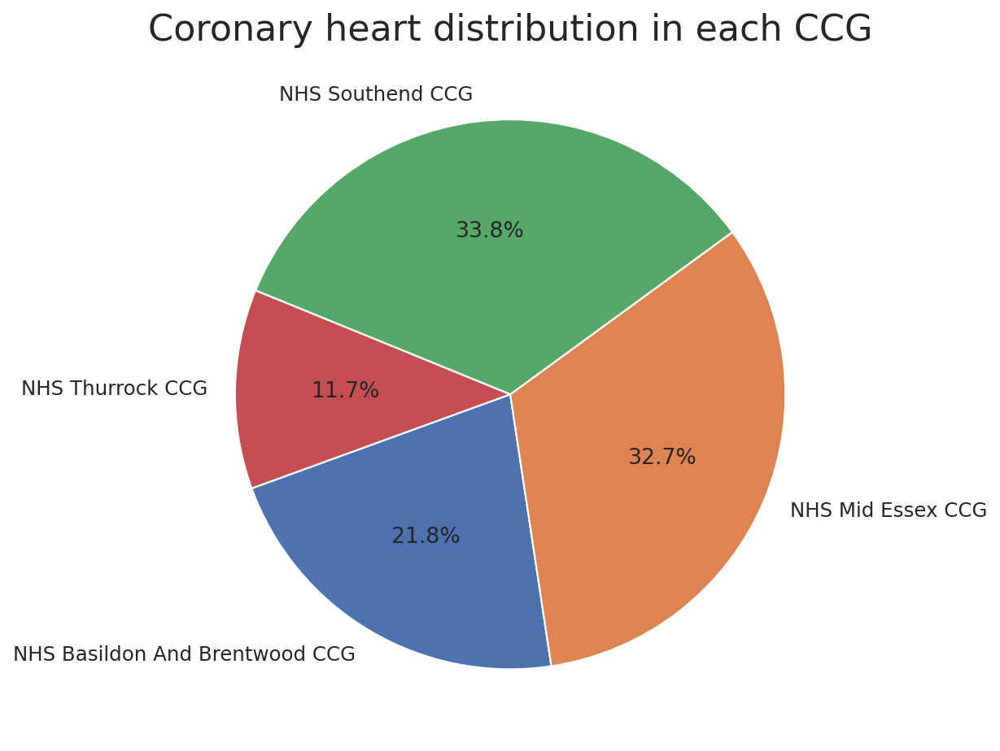

In [ ]:
#Pie chart plot of sum of chd patients in eacg CCG
plt.figure(figsize=(7,7))
b= pd.DataFrame(df_2021.groupby('CCG Name')['chd_patients'].sum())
l = (np.array(b.index))
s = (np.array((b / b.sum())*100))
plt.pie(s, labels=l, autopct='%1.1f%%', startangle=200)
plt.title("Coronary heart distribution in each CCG", fontsize=20)
plt.show();

In [ ]:
#Sum of people in each CCG
df_2021.groupby('CCG Name')['chd_patients'].sum()

CCG Name
NHS Basildon And Brentwood CCG     7916.0
NHS Mid Essex CCG                 11843.0
NHS Southend CCG                  12249.0
NHS Thurrock CCG                   4252.0
Name: chd_patients, dtype: float64

NHS Southend recorded the highest number of CHD in 2021

In [ ]:
# Population of each CCG
df_2021.groupby('CCG Name')['Total Population'].sum()

CCG Name
NHS Basildon And Brentwood CCG    287269.0
NHS Mid Essex CCG                 407906.0
NHS Southend CCG                  377523.0
NHS Thurrock CCG                  184994.0
Name: Total Population, dtype: float64

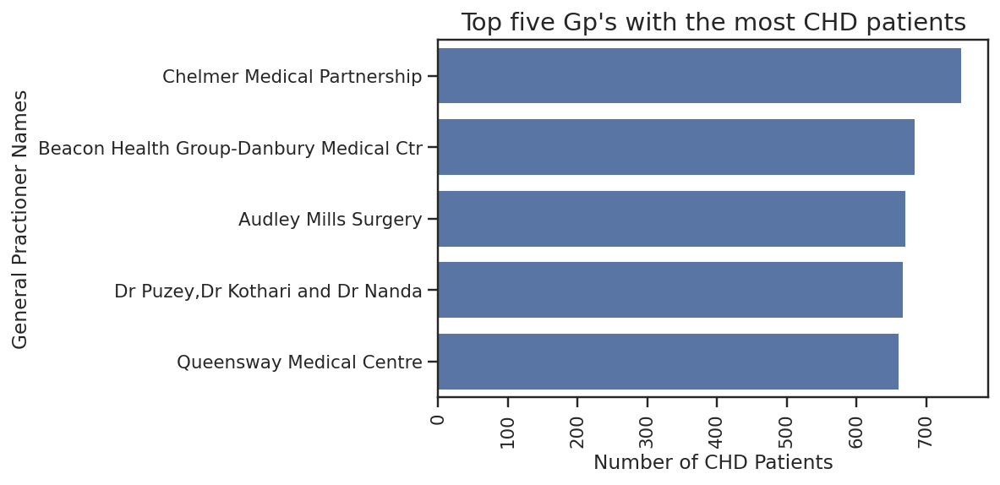

In [ ]:
#Visualising the top 10 gps with high number of coronary heart disease patients
a = pd.DataFrame(df_2021.nlargest(5,['chd_patients']))
base_color = sb.color_palette()[0]
sb.barplot(data=a, x="chd_patients", y="GP Name", color = base_color)
plt.xticks(rotation =90);
plt.title("Top five Gp's with the most CHD patients", fontsize=15)
plt.ylabel('General Practioner Names')
plt.xlabel('Number of CHD Patients');

In [ ]:
#Details of the GP with highest recorded CHD patients
df_2021.nlargest(5,['chd_patients']).T

,0,1,2,3,4
CCG Code,E38000106,E38000106,E38000030,E38000030,E38000168
CCG Name,NHS Mid Essex CCG,NHS Mid Essex CCG,NHS Southend CCG,NHS Southend CCG,NHS Southend CCG
GP Code,F81122,F81100,F81123,F81007,F81081
GP Name,Chelmer Medical Partnership,Beacon Health Group-Danbury Medical Ctr,Audley Mills Surgery,"Dr Puzey,Dr Kothari and Dr Nanda",Queensway Medical Centre
Total Population,28135.0,25599.0,20685.0,20774.0,20209.0
0_4,1373.0,1176.0,956.0,991.0,1025.0
10_14,1859.0,1549.0,1264.0,1280.0,1278.0
5_9,1761.0,1403.0,1184.0,1178.0,1181.0
15_19,1718.0,1485.0,1144.0,1148.0,1099.0
20_24,1402.0,1231.0,919.0,1123.0,1189.0


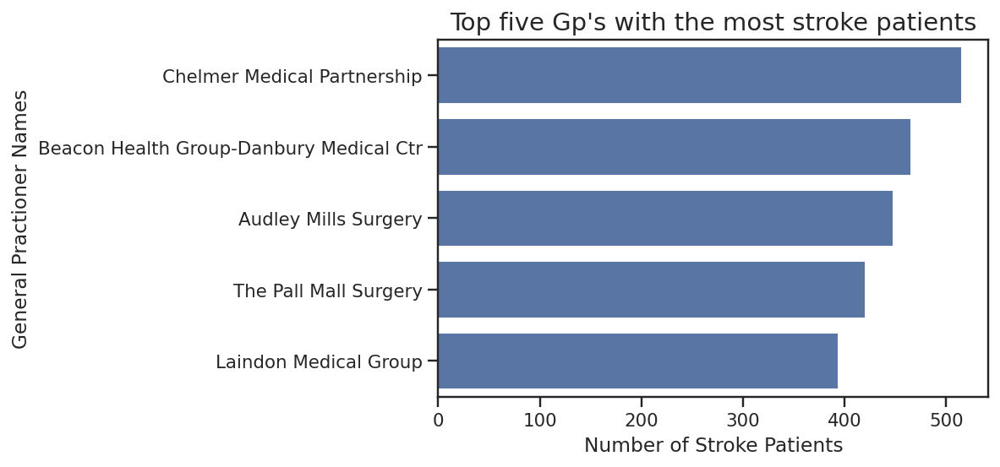

In [ ]:
#Visualising the top 5 gps with high number of stroke patients
a = pd.DataFrame(df_2021.nlargest(5,['stroke_patients']))
base_color = sb.color_palette()[0]
sb.barplot(data=a, x="stroke_patients", y="GP Name", color = base_color)
plt.title("Top five Gp's with the most stroke patients", fontsize=15)
plt.ylabel('General Practioner Names')
plt.xlabel('Number of Stroke Patients');

In [ ]:
#Details of highest recorded stroke patients 
df_2021.nlargest(5,['stroke_patients']).T

,0,1,2,5,6
CCG Code,E38000106,E38000106,E38000030,E38000168,E38000007
CCG Name,NHS Mid Essex CCG,NHS Mid Essex CCG,NHS Southend CCG,NHS Southend CCG,NHS Basildon And Brentwood CCG
GP Code,F81122,F81100,F81123,F81144,F81108
GP Name,Chelmer Medical Partnership,Beacon Health Group-Danbury Medical Ctr,Audley Mills Surgery,The Pall Mall Surgery,Laindon Medical Group
Total Population,28135.0,25599.0,20685.0,21548.0,17729.0
0_4,1373.0,1176.0,956.0,1162.0,906.0
10_14,1859.0,1549.0,1264.0,1442.0,1214.0
5_9,1761.0,1403.0,1184.0,1423.0,1073.0
15_19,1718.0,1485.0,1144.0,1099.0,1127.0
20_24,1402.0,1231.0,919.0,911.0,966.0


The most populous CCG is NHS mid Essex, followed by NHS Southend, while NHS Thurrock has the least number of residents.

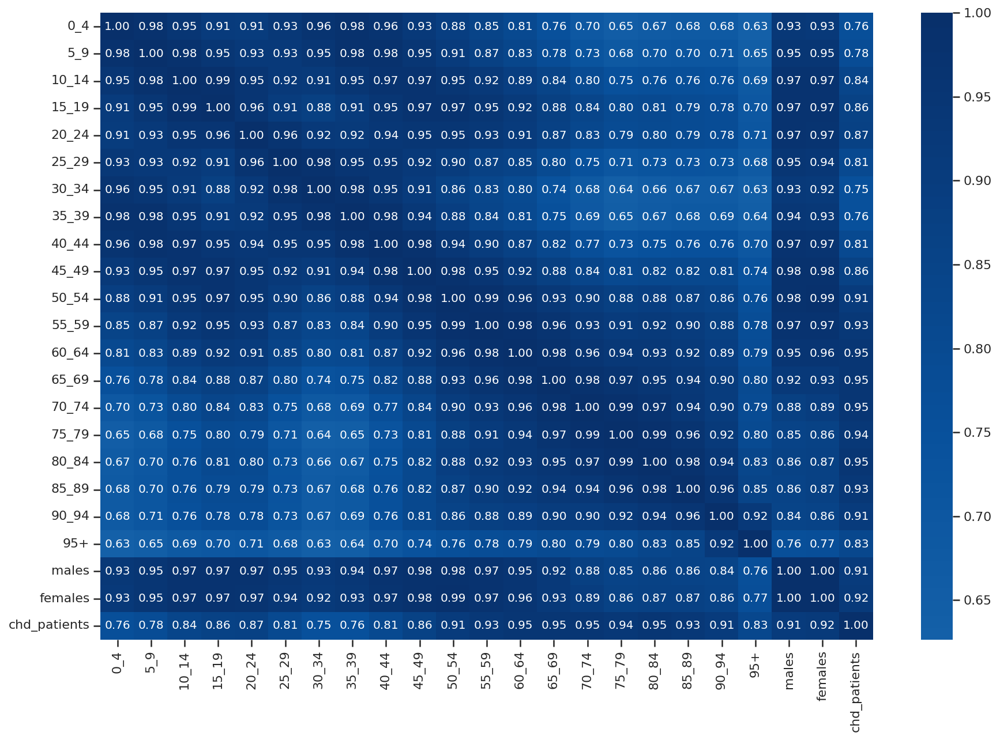

In [13]:
#Correlation betwwen age group and percentage of patients with CHD, 
num =['0_4','5_9','10_14','15_19','20_24','25_29','30_34','35_39','40_44', '45_49', \
      '50_54', '55_59', '60_64', '65_69', '70_74', '75_79', \
      '80_84','85_89', '90_94', '95+', 'males', 'females', 'chd_patients']

#Correlation
cor = df_2021[num].corr()
plt.figure(figsize = [15, 10])
sb.heatmap(cor, annot = True, fmt = '.2f', center = 0, cmap = 'Blues')
plt.show()

In [ ]:

# Pairplot of the age groups
sb.pairplot(data=df_2021[num], vars=num)
plt.show()


> The above plot shows strong linear relationships between the age groups and chd patients

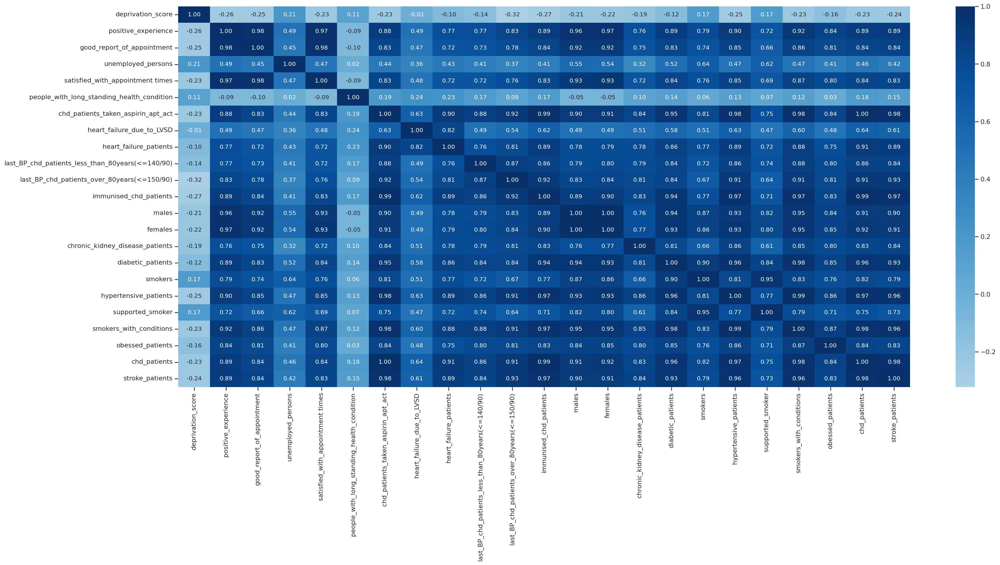

In [ ]:
#Correlation between the features in the data 

num3 =['deprivation_score', 'positive_experience','good_report_of_appointment',\
       'unemployed_persons', 'satisfied_with_appointment times', \
       'people_with_long_standing_health_condition', ' chd_patients_taken_aspirin_apt_act', \
       'heart_failure_due_to_LVSD', 'heart_failure_patients', \
       'last_BP_chd_patients_less_than_80years(<=140/90)', \
       'last_BP_chd_patients_over_80years(<=150/90)', 'immunised_chd_patients', \
       'males', 'females', 'chronic_kidney_disease_patients','diabetic_patients', \
       'smokers', 'hypertensive_patients', ' supported_smoker', 'smokers_with_conditions',\
       'obessed_patients', 'chd_patients', 'stroke_patients']

#Correlation of features
cor = df_2021[num3].corr()
plt.figure(figsize = [25, 12])
sb.heatmap(cor, annot = True, fmt = '.2f', center = 0, cmap = 'Blues')
plt.show()

> There is a strong positive linear relationships among the variables except for the deprivation score and the people with long standing health conditions

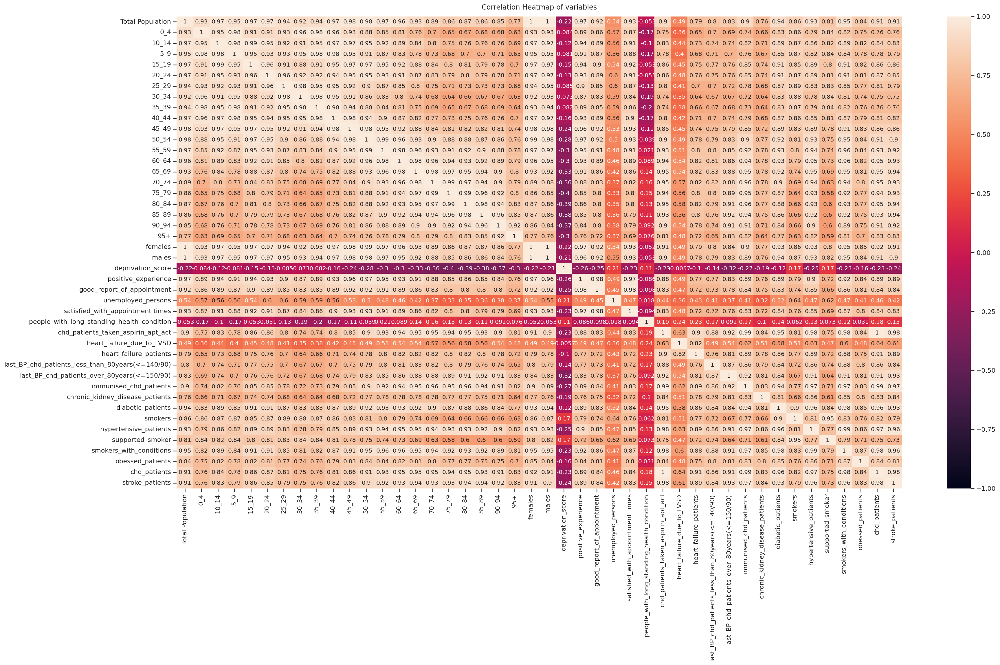

In [ ]:
# Plotting the correlation heatmap of the all the variables in the 2021 dataset.
plt.figure(figsize=(25, 15))
h = sb.heatmap(df_2021.corr(), vmin=-1, vmax=1, annot=True)
h.set_title('Correlation Heatmap of variables', fontdict={'fontsize':12}, pad=12);

## Data Wrangling 

In [14]:
#Dropping rows with missing values
df_2021.dropna(inplace = True)

In [15]:
#Confirming that there are no missing values again
df_2021.isna().sum()

CCG Code                                            0
CCG Name                                            0
GP Code                                             0
GP Name                                             0
Total Population                                    0
0_4                                                 0
10_14                                               0
5_9                                                 0
15_19                                               0
20_24                                               0
25_29                                               0
30_34                                               0
35_39                                               0
40_44                                               0
45_49                                               0
50_54                                               0
55_59                                               0
60_64                                               0
65_69                       

In [ ]:
#New size of the dataframe  after dropping missing values
df_2021.shape

(148, 48)

In [16]:
 #Melting the age column into different age groups that will be saved in a single column

age_group = pd.melt(df_2021, id_vars=['GP Code'],\
                    value_vars=['0_4','5_9','10_14','15_19','20_24','25_29',\
                                '30_34','35_39','40_44', '45_49',  '50_54', \
                                '55_59', '60_64', '65_69', '70_74', '75_79', \
                                '80_84','85_89', '90_94', '95+'],
              var_name='Age_group', value_name='Age_group_count')
age_group

,GP Code,Age_group,Age_group_count
0,F81122,0_4,1373.0
1,F81100,0_4,1176.0
2,F81123,0_4,956.0
3,F81007,0_4,991.0
4,F81081,0_4,1025.0
...,...,...,...
2955,Y00758,95+,2.0
2956,F81713,95+,5.0
2957,F81207,95+,10.0
2958,F81737,95+,1.0


In [17]:
#size of the age group dataframe
age_group.shape

(2960, 3)

In [18]:
#merging the age group with the df and saving in another dataframe
merge1 =  df_2021.merge(age_group, how='outer')
merge1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2960 entries, 0 to 2959
Data columns (total 50 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   CCG Code                                          2960 non-null   object 
 1   CCG Name                                          2960 non-null   object 
 2   GP Code                                           2960 non-null   object 
 3   GP Name                                           2960 non-null   object 
 4   Total Population                                  2960 non-null   float64
 5   0_4                                               2960 non-null   float64
 6   10_14                                             2960 non-null   float64
 7   5_9                                               2960 non-null   float64
 8   15_19                                             2960 non-null   float64
 9   20_24              

In [19]:
#Dropping the age group columns since it has been merged
cols = ['0_4','5_9','10_14','15_19','20_24','25_29',\
        '30_34','35_39','40_44', '45_49',  '50_54', \
        '55_59', '60_64', '65_69', '70_74', '75_79', \
      '80_84','85_89', '90_94', '95+']
merge1.drop(columns = cols, axis = 1, inplace = True)

In [20]:
#Confirming age group columns have been dropped
merge1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2960 entries, 0 to 2959
Data columns (total 30 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   CCG Code                                          2960 non-null   object 
 1   CCG Name                                          2960 non-null   object 
 2   GP Code                                           2960 non-null   object 
 3   GP Name                                           2960 non-null   object 
 4   Total Population                                  2960 non-null   float64
 5   females                                           2960 non-null   float64
 6   males                                             2960 non-null   float64
 7   deprivation_score                                 2960 non-null   float64
 8   positive_experience                               2960 non-null   float64
 9   good_report_of_appo

> Now we have only 30 columns after melting the data groups into one column

In [21]:
#Melting the gender column using the merge1 dataframe 
gender = pd.melt(merge1, id_vars=['GP Code'], value_vars=['males', 'females'],\
              var_name='Gender', value_name='Gender_count')
gender

,GP Code,Gender,Gender_count
0,F81122,males,13917.0
1,F81122,males,13917.0
2,F81122,males,13917.0
3,F81122,males,13917.0
4,F81122,males,13917.0
...,...,...,...
5915,F81218,females,1711.0
5916,F81218,females,1711.0
5917,F81218,females,1711.0
5918,F81218,females,1711.0


In [22]:
#Merging the melted columns with the age group
df_merge = pd.merge(merge1,gender, on=['GP Code'])
df_merge.head()

,CCG Code,CCG Name,GP Code,GP Name,Total Population,females,males,deprivation_score,positive_experience,good_report_of_appointment,...,hypertensive_patients,supported_smoker,smokers_with_conditions,obessed_patients,chd_patients,stroke_patients,Age_group,Age_group_count,Gender,Gender_count
0,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,14218.0,13917.0,17.81353,22596.455347,18314.869994,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,0_4,1373.0,males,13917.0
1,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,14218.0,13917.0,17.81353,22596.455347,18314.869994,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,0_4,1373.0,males,13917.0
2,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,14218.0,13917.0,17.81353,22596.455347,18314.869994,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,0_4,1373.0,males,13917.0
3,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,14218.0,13917.0,17.81353,22596.455347,18314.869994,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,0_4,1373.0,males,13917.0
4,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,14218.0,13917.0,17.81353,22596.455347,18314.869994,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,0_4,1373.0,males,13917.0


In [23]:
#Shape of the merged data 
df_merge.shape

(118400, 32)

In [24]:
#Dropping the males and females columns since it has been melted
cols = ['males', 'females']
df_merge.drop(columns = cols, axis = 1, inplace = True)

In [ ]:
df_merge.shape

(118400, 30)

> Now we have a dataframe with 118400 rows and 30 columns

In [25]:
#Let us check for duplicates
df_merge.duplicated().sum()

112480

> There are 112480 duplicates after merging the dataframes and has to be dropped before using the dataframe in the model

In [26]:
#Dropping the duplicates
df_merge.drop_duplicates(keep='first', inplace=True, ignore_index=True)

In [27]:
#Checking the size of the data after dropping the duplicates
df_merge.shape

(5920, 30)

In [28]:
df_merge.head(10)

,CCG Code,CCG Name,GP Code,GP Name,Total Population,deprivation_score,positive_experience,good_report_of_appointment,unemployed_persons,satisfied_with_appointment times,...,hypertensive_patients,supported_smoker,smokers_with_conditions,obessed_patients,chd_patients,stroke_patients,Age_group,Age_group_count,Gender,Gender_count
0,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,17.81353,22596.455347,18314.869994,529.316084,16682.321156,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,0_4,1373.0,males,13917.0
1,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,17.81353,22596.455347,18314.869994,529.316084,16682.321156,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,0_4,1373.0,females,14218.0
2,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,17.81353,22596.455347,18314.869994,529.316084,16682.321156,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,5_9,1761.0,males,13917.0
3,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,17.81353,22596.455347,18314.869994,529.316084,16682.321156,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,5_9,1761.0,females,14218.0
4,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,17.81353,22596.455347,18314.869994,529.316084,16682.321156,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,10_14,1859.0,males,13917.0
5,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,17.81353,22596.455347,18314.869994,529.316084,16682.321156,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,10_14,1859.0,females,14218.0
6,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,17.81353,22596.455347,18314.869994,529.316084,16682.321156,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,15_19,1718.0,males,13917.0
7,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,17.81353,22596.455347,18314.869994,529.316084,16682.321156,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,15_19,1718.0,females,14218.0
8,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,17.81353,22596.455347,18314.869994,529.316084,16682.321156,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,20_24,1402.0,males,13917.0
9,E38000106,NHS Mid Essex CCG,F81122,Chelmer Medical Partnership,28135.0,17.81353,22596.455347,18314.869994,529.316084,16682.321156,...,3424.0,2181.0,5464.0,885.0,752.0,516.0,20_24,1402.0,females,14218.0


## Data Visualisation and Analysis

**Question:** What is the proption of females to males in each GP region

In [29]:
df_merge['Gender'].value_counts()

males      2960
females    2960
Name: Gender, dtype: int64

> There are equal number of males and females in the dataset

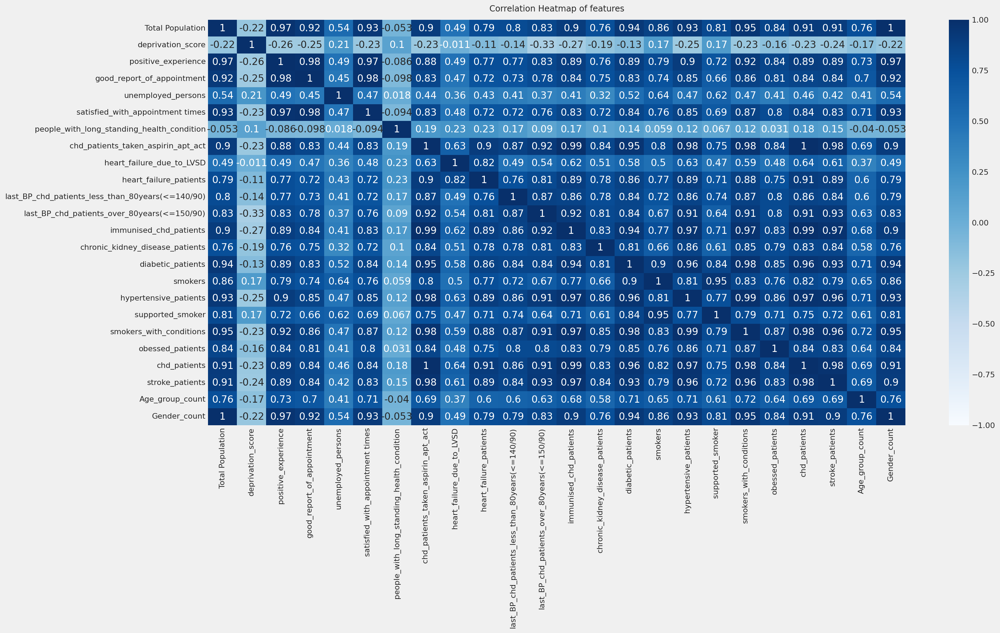

In [ ]:
# Plotting the correlation heatmap of the variables after melting the columns
plt.figure(figsize=(20, 10))
heat = sb.heatmap(df_merge.corr(), vmin=-1, vmax=1, annot=True,  cmap="Blues")
heat.set_title('Correlation Heatmap of features', fontdict={'fontsize':12}, pad=12);

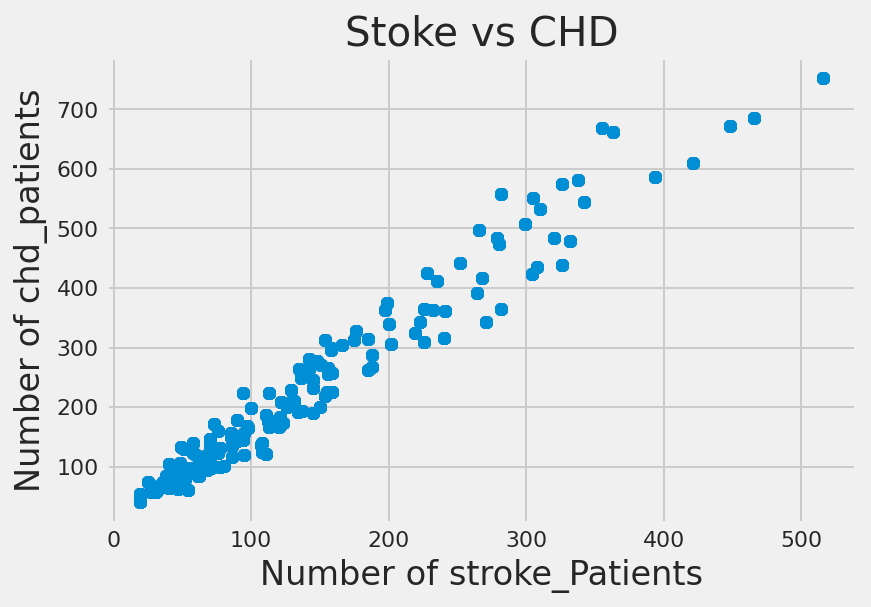

In [ ]:
plt.scatter(df_merge['stroke_patients'], df_merge['chd_patients'])
plt.xlabel('Number of stroke_Patients')
plt.ylabel('Number of chd_patients')
plt.title ('Stoke vs CHD')
plt.show()

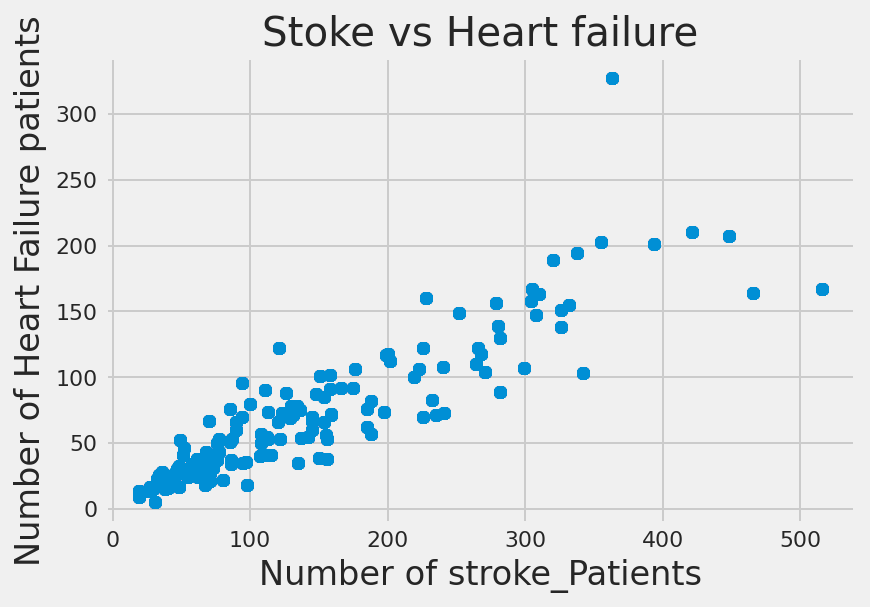

In [ ]:
plt.scatter(df_merge['stroke_patients'], df_merge['heart_failure_patients'])
plt.xlabel('Number of stroke_Patients')
plt.ylabel('Number of Heart Failure patients')
plt.title ('Stoke vs Heart failure')
plt.show()

**Question:** What region recorded the highest percentage of chd patients

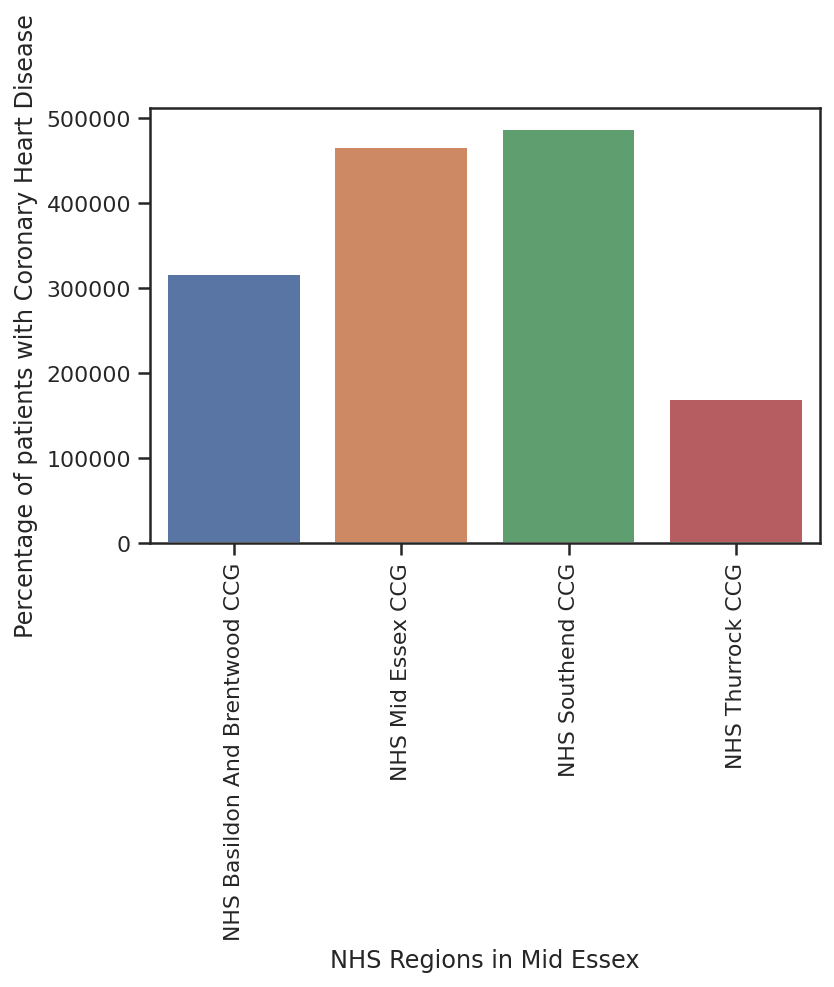

In [30]:
b = pd.DataFrame(df_merge.groupby('CCG Name')['chd_patients'].sum())
b.reset_index(inplace = True)

sb.barplot(x='CCG Name', y='chd_patients', data=b)
plt.xticks(rotation =90)
plt.xlabel('NHS Regions in Mid Essex')
plt.ylabel('Percentage of patients with Coronary Heart Disease');

> Most chd patients are in Southend and Mid Essex. Thrrock has the least percentage of CHD patients

**Question:** What is the detais of the highest value of number of chd patients

In [31]:
#Details on the Gp who has the highest proportion of chd patients 
df_merge.loc[df_merge['chd_patients'].idxmax()]

CCG Code                                                              E38000106
CCG Name                                                      NHS Mid Essex CCG
GP Code                                                                  F81122
GP Name                                             Chelmer Medical Partnership
Total Population                                                        28135.0
deprivation_score                                                      17.81353
positive_experience                                                22596.455347
good_report_of_appointment                                         18314.869994
unemployed_persons                                                   529.316084
satisfied_with_appointment times                                   16682.321156
people_with_long_standing_health_condition                            50.410777
 chd_patients_taken_aspirin_apt_act                                       646.0
heart_failure_due_to_LVSD               

In [ ]:
#Details on the Gp who has the highest proportion of stroke patients 
df_merge.loc[df_merge['stroke_patients'].idxmax()]

CCG Code                                                              E38000106
CCG Name                                                      NHS Mid Essex CCG
GP Code                                                                  F81122
GP Name                                             Chelmer Medical Partnership
Total Population                                                        28135.0
deprivation_score                                                      17.81353
positive_experience                                                22596.455347
good_report_of_appointment                                         18314.869994
unemployed_persons                                                   529.316084
satisfied_with_appointment times                                   16682.321156
people_with_long_standing_health_condition                            50.410777
 chd_patients_taken_aspirin_apt_act                                       646.0
heart_failure_due_to_LVSD               

> The above result shows thatChelmer Medical Partnership recorded the highest number of CHD patients and stroke patients

In [ ]:
#Details on the Gp who has the highest population
df_merge.loc[df_merge['Total Population'].idxmax()]

CCG Code                                                              E38000106
CCG Name                                                      NHS Mid Essex CCG
GP Code                                                                  F81122
GP Name                                             Chelmer Medical Partnership
Total Population                                                        28135.0
deprivation_score                                                      17.81353
positive_experience                                                22596.455347
good_report_of_appointment                                         18314.869994
unemployed_persons                                                   529.316084
satisfied_with_appointment times                                   16682.321156
people_with_long_standing_health_condition                            50.410777
 chd_patients_taken_aspirin_apt_act                                       646.0
heart_failure_due_to_LVSD               

>Chelmer Medical Partnership has the most people registered with it, with a population of 28135, and 752  of its patients have Coronary heart disease.

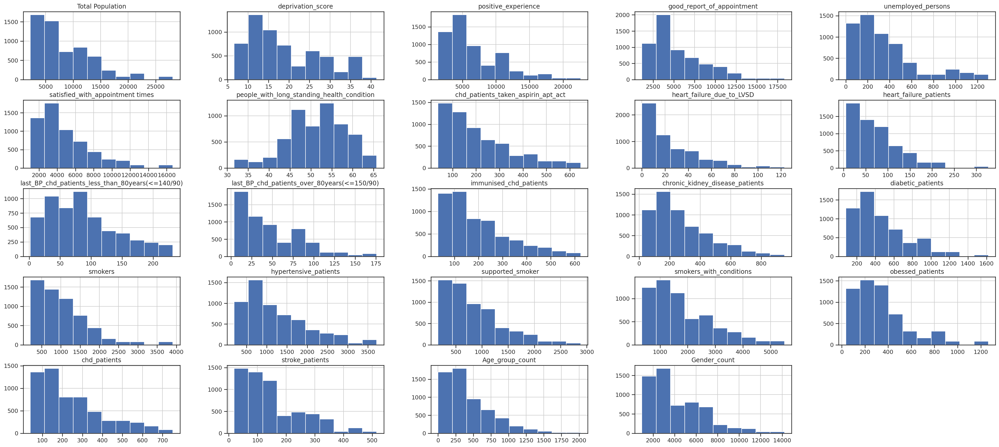

In [ ]:
#Histogram plot of the entire dataset
df_merge.hist(figsize=(30,15));

> We can see that alot of the data variables are skewed to the right

## Model using chd as 'y'

In [32]:
#Making a copy of the dataset before using in model 
df_model = df_merge.copy()

In [33]:
#Dropping columns that are not needed in the model
cols = ['CCG Code', 'Total Population', 'GP Code', 'GP Name']
df_model.drop(columns = cols, axis= 1, inplace = True)

In [34]:
# Transforming the categorical data into numerical data using dummies
dum1= pd.get_dummies(df_model['CCG Name'])
dum2= pd.get_dummies(df_model['Age_group'])
dum3 = pd.get_dummies(df_model['Gender'])

In [35]:
# Concatenate the dummies generated to original dataframe 
merged = pd.concat([df_model, dum1, dum2, dum3], axis='columns')

In [36]:
# drop the values
merged.drop(['Age_group', 'Age_group_count', 'CCG Name','Gender'], axis='columns', inplace = True)

In [37]:
#Renaming the chd column to y
merged.rename(columns = {'chd_patients':'y'}, inplace = True)

In [ ]:
#Splitting dataset
X = merged.loc[:, merged.columns != 'y']
y = merged.loc[:, merged.columns == 'y']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

### Feature Selection

In [ ]:
#Feature selection using Recursive Feature Elimination

lr = LinearRegression()
rfe = RFE(estimator=lr)
#rfe = RFE(lin, 6)
rfe = rfe.fit(X_train, y_train.values.ravel())
print(rfe.support_)
print(rfe.ranking_)

[ True False False False False  True  True  True  True False False  True
 False False False False False False False False False  True False  True
  True  True  True False False  True  True  True  True  True  True False
  True  True False False  True False  True False  True  True False]
[ 1 24 19 16 20  1  1  1  1  5  6  1 12 25  7 13 17 14 18 11 22  1  4  1
  1  1  1 10  8  1  1  1  1  1  1  9  1  1  2 21  1 23  1 15  1  1  3]


The RFE suggest that some of the features are not relevant, the features include,
- `positive_experience`, 
- `good_report_of_appointment`, 
- `unemployed_persons`,
- `satisfied_with_appointment times`,
- `last_BP_chd_patients_over_80years(<=150/90)`, -   `chronic_kidney_disease_patients` ,
- `smokers`,
- `hypertensive_patients`,
- `supported_smoker`, 
- `smokers_with_conditions`, 
- `obessed_patients`, 
- `stroke_patients`, 
- `Gender_count`

### Feature selection with Lasso Regreession

In [ ]:
#Using standard scaler
pi = Pipeline([ ('scaler',StandardScaler()),
                     ('model',Lasso())])

In [ ]:
sch = GridSearchCV(pi,
                      {'model__alpha':np.arange(0.1,10,0.1)},
                      cv = 5, scoring="neg_mean_squared_error",verbose=3
                      )
#Scaling the varibles
sch.fit(X_train,y_train)

Fitting 5 folds for each of 99 candidates, totalling 495 fits
[CV 1/5] END ................model__alpha=0.1;, score=-86.290 total time=   0.1s
[CV 2/5] END ................model__alpha=0.1;, score=-96.482 total time=   0.1s
[CV 3/5] END ................model__alpha=0.1;, score=-95.766 total time=   0.1s
[CV 4/5] END ................model__alpha=0.1;, score=-94.019 total time=   0.1s
[CV 5/5] END ................model__alpha=0.1;, score=-85.864 total time=   0.1s
[CV 1/5] END ................model__alpha=0.2;, score=-89.187 total time=   0.1s
[CV 2/5] END ................model__alpha=0.2;, score=-99.330 total time=   0.1s
[CV 3/5] END ................model__alpha=0.2;, score=-99.136 total time=   0.1s
[CV 4/5] END ................model__alpha=0.2;, score=-95.968 total time=   0.1s
[CV 5/5] END ................model__alpha=0.2;, score=-88.436 total time=   0.1s
[CV 1/5] END model__alpha=0.30000000000000004;, score=-91.261 total time=   0.1s
[CV 2/5] END model__alpha=0.30000000000000004;,

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('model', Lasso())]),
             param_grid={'model__alpha': array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2, 1.3,
       1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2, 2.3, 2.4, 2.5, 2.6,
       2.7, 2.8, 2.9, 3. , 3.1, 3.2, 3.3, 3.4, 3.5, 3.6, 3.7, 3.8, 3.9,
       4. , 4.1, 4.2, 4.3, 4.4, 4.5, 4.6, 4.7, 4.8, 4.9, 5. , 5.1, 5.2,
       5.3, 5.4, 5.5, 5.6, 5.7, 5.8, 5.9, 6. , 6.1, 6.2, 6.3, 6.4, 6.5,
       6.6, 6.7, 6.8, 6.9, 7. , 7.1, 7.2, 7.3, 7.4, 7.5, 7.6, 7.7, 7.8,
       7.9, 8. , 8.1, 8.2, 8.3, 8.4, 8.5, 8.6, 8.7, 8.8, 8.9, 9. , 9.1,
       9.2, 9.3, 9.4, 9.5, 9.6, 9.7, 9.8, 9.9])},
             scoring='neg_mean_squared_error', verbose=3)

In [ ]:
#Searching for the value of the best parameter
sch.best_params_



{'model__alpha': 0.1}

In [ ]:
#Extracting the coefficients 
coef = sch.best_estimator_.named_steps['model'].coef_

In [ ]:
#Extracting the coefficients
imp = np.abs(coef)
imp

array([2.47717470e+00, 0.00000000e+00, 1.73340559e+00, 2.46662106e+00,
       1.38334445e+00, 1.43439139e+00, 5.22500216e+01, 3.61545255e+00,
       9.25399720e+00, 4.39056025e+00, 5.75761717e+00, 8.24990530e+01,
       1.85075631e+00, 1.61016493e+00, 1.58663052e+01, 0.00000000e+00,
       2.23244175e+00, 5.45704537e-01, 1.77367009e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 1.45672258e-02, 3.16085468e+00,
       5.59357006e-01, 3.08389490e-02, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 1.71239185e-02, 2.70486857e-02, 0.00000000e+00,
       0.00000000e+00, 5.55928738e-02, 0.00000000e+00, 0.00000000e+00,
       5.61065371e-02, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00])

In [ ]:
#Extracting the features with best features
F = pd.DataFrame(merged.loc[:, merged.columns != 'y'])
important_features = F.columns
np.array(important_features)[imp > 0]

array(['deprivation_score', 'good_report_of_appointment',
       'unemployed_persons', 'satisfied_with_appointment times',
       'people_with_long_standing_health_condition',
       ' chd_patients_taken_aspirin_apt_act', 'heart_failure_due_to_LVSD',
       'heart_failure_patients',
       'last_BP_chd_patients_less_than_80years(<=140/90)',
       'last_BP_chd_patients_over_80years(<=150/90)',
       'immunised_chd_patients', 'chronic_kidney_disease_patients',
       'diabetic_patients', 'smokers', ' supported_smoker',
       'smokers_with_conditions', 'obessed_patients', 'NHS Mid Essex CCG',
       'NHS Southend CCG', 'NHS Thurrock CCG', '0_4', '45_49', '50_54',
       '60_64', '75_79'], dtype=object)

In [ ]:
#Extracting worst features
np.array(important_features)[imp== 0]

array(['positive_experience', 'hypertensive_patients', 'stroke_patients',
       'Gender_count', 'NHS Basildon And Brentwood CCG', '10_14', '15_19',
       '20_24', '25_29', '30_34', '35_39', '40_44', '55_59', '5_9',
       '65_69', '70_74', '80_84', '85_89', '90_94', '95+', 'females',
       'males'], dtype=object)

 ## **Linear Regression Model**

In [ ]:

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [ ]:
lin = LinearRegression()
lin.fit(X_train, y_train)

LinearRegression()

In [ ]:
y_pred = lin.predict(X_test)
print("R squared value of the linear Regression model of the test: {:.2f}".format(r2_score(y_test, y_pred)))

R squared value of the linear Regression model of the test: 1.00


In [ ]:
#Mean Squared Error
print("Linear Regression MSE of the test set is: {:.2f}".format(mean_squared_error(y_test, y_pred)))

Linear Regression MSE of the test set is: 85.66


**Mean absolute error**



In [ ]:
#Mean absolute error
print("Linear Regression MAE of the test set is: {:.2f}".format(mean_absolute_error(y_test, pred)))

Linear Regression MAE of the test set is: 6.87


In [ ]:

df_p= pd.DataFrame({'true': [y_test], 'predicted': [pred]})
df_p['diff'] = df_p['predicted']-df_p['true']

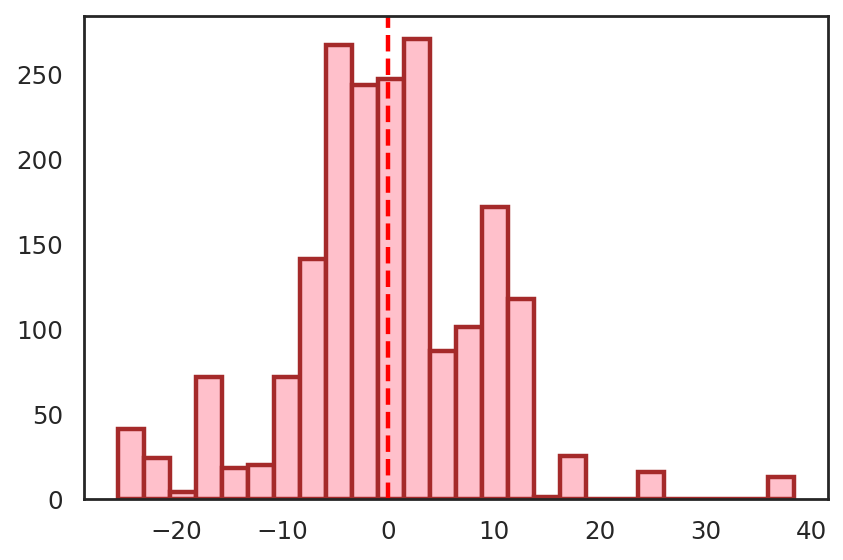

In [ ]:
#Check for over estimation 
sb.set(style="white")
plt.hist(df_p['diff'], bins=26, color="pink", edgecolor='brown', linewidth=2)
plt.axvline(0, color="red", linestyle='dashed', linewidth=2)
plt.show()

In [ ]:
prediction = lin.predict(X_test)
prediction.max()

762.8075590839801

In [ ]:
prediction = lin.predict(X_test)
plt.scatter(y_test, prediction)
plt.xlabel('Actual number of chd patients')
plt.ylabel('Predicted number of chd patients')

coeff_df = pd.DataFrame(X_train.columns.delete(0))
coeff_df.columns = ['Feature']
coeff_df["Correlation"] = pd.Series(lin.coef_[0])

coeff_df.sort_values(by='Correlation', ascending=False)


Text(0, 0.5, 'Predicted number of chd patients')

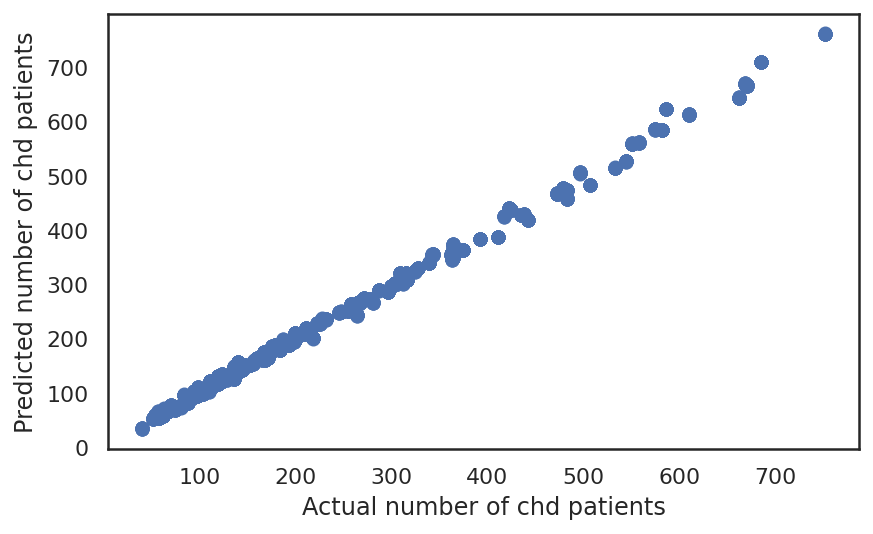

In [ ]:
plt.scatter(y_test, prediction)
plt.xlabel('Actual number of chd patients')
plt.ylabel('Predicted number of chd patients')

In [ ]:
#Value of R squared
print(lin.score(X_test, y_test))

0.996997426473792


In [ ]:
coeff_df = pd.DataFrame(X_train.columns.delete(0))
coeff_df.columns = ['Feature']
coeff_df["Correlation"] = pd.Series(lin.coef_[0])

coeff_df.sort_values(by='Correlation', ascending=False)


,Feature,Correlation
23,NHS Thurrock CCG,6.470612
25,10_14,0.705362
11,chronic_kidney_disease_patients,0.607757
33,50_54,0.432455
6,heart_failure_due_to_LVSD,0.396358
44,females,0.228736
10,immunised_chd_patients,0.222684
8,last_BP_chd_patients_less_than_80years(<=140/90),0.205025
27,20_24,0.198265
5,chd_patients_taken_aspirin_apt_act,0.185230


In [ ]:
print(metrics.mean_squared_error(y_test, prediction))

85.66461846842269


In [ ]:
print(f"intercept: {model.intercept_}")


intercept: [-1.86203916]


In [ ]:
print(f"intercept: {lin.intercept_}")


intercept: [-2.2467173]


In [ ]:
print(f"slope: {lin.coef_}")


slope: [[-3.94434844e-01  1.31296745e-03 -3.21860456e-03  1.22476387e-02
   2.35181488e-03  1.85229853e-01  3.96358062e-01 -2.08429542e-01
   2.05025309e-01 -1.18362267e-01  2.22684117e-01  6.07757432e-01
   1.66263623e-02  6.75526461e-04  2.78762979e-02 -2.44099127e-02
  -7.10933493e-03  1.90959974e-02  6.84812316e-03 -1.79748284e-02
  -2.47851631e-03 -7.31198464e-01 -3.02180111e+00  6.47061226e+00
  -2.71761268e+00  7.05362277e-01  3.82008815e-02  1.98264815e-01
   5.34572241e-02  7.39313392e-02 -1.58337868e-01  9.98301063e-02
   8.92381929e-02  4.32455300e-01 -5.79012679e-01 -5.55685103e-02
  -7.13861406e-02 -6.37949036e-01  3.85049569e-02 -2.51371644e-02
  -4.35021989e-01 -5.12233839e-02 -1.01486329e-01  1.57142244e-01
   2.28735762e-01  1.21162548e-01 -1.21162548e-01]]


In [ ]:
import statsmodels.api as sm
from scipy import stats

In [ ]:
X2 = sm.add_constant(X)
est = sm.OLS(y, X2)
est2 = est.fit()
print(est2.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.997
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                 4.236e+04
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        05:39:12   Log-Likelihood:                -21512.
No. Observations:                5920   AIC:                         4.311e+04
Df Residuals:                    5875   BIC:                         4.341e+04
Df Model:                          44                                         
Covariance Type:            nonrobust                                         
                                                       coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------

## Other Models



In [ ]:
from sklearn.linear_model import LinearRegression 
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso 
from sklearn.linear_model import BayesianRidge 
from sklearn.linear_model import ElasticNet

In [ ]:
from sklearn.metrics import explained_variance_score as evs

In [ ]:
ls = LinearRegression()
ls.fit(X_train, y_train)
ls_yhat = ls.predict(X_test)


In [ ]:
print('Explained Variance Score of OLS model is {}'.format(evs(y_test, ls_yhat)))

Explained Variance Score of OLS model is 0.9969982366158325


In [ ]:
#Lasso Regression
las = Lasso(alpha = 0.01)
las.fit(X_train, y_train)
las_yhat = las.predict(X_test)

/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.609e+05, tolerance: 1.022e+04



In [ ]:
print('Variance Score for Lasso model is {}'.format(evs(y_test, las_yhat)))

Variance Score for Lasso model is 0.9970060370411231


In [ ]:
#Ridge
ridge = Ridge(alpha = 0.5)
ridge.fit(X_train, y_train)
ridge_yhat = ridge.predict(X_test)


In [ ]:
print('Variance score for ridge model is {}'.format(evs(y_test, ridge_yhat)))

Explained Variance Score of Ridge model is 0.9969982989472428


In [ ]:
#Using ElasticNet Model

enet = ElasticNet(alpha = 0.01)
enet.fit(X_train, y_train)
enet_yhat = enet.predict(X_test)

/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.638e+05, tolerance: 1.022e+04



In [ ]:
print('Variance score for ElasticNet model is {}'.format(evs(y_test, enet_yhat)))

Explained Variance Score of ElasticNet is 0.9970035665344332


In [ ]:
#Using bayesian ridge
bay = BayesianRidge()
bay.fit(X_train, y_train)
bay_yhat = bay.predict(X_test)


/usr/local/lib/python3.8/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



## Decision Tree Model


In [38]:
from sklearn.tree import plot_tree


In [39]:
#Splitting dataset
X = merged.loc[:, merged.columns != 'y']
y = merged.loc[:, merged.columns == 'y']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [40]:
# model 
model = DecisionTreeRegressor(random_state=44)
model.fit(X_train, y_train)
predictions = model.predict(X_test)

In [43]:
X_grid = np.arange(min(X), max(X), 0.01)
  
# reshape for reshaping the data into 
# a len(X_grid)*1 array, i.e. to make
# a column out of the X_grid values
X_grid = X_grid.reshape((len(X_grid), 1)) 
  
# scatter plot for original data
plt.scatter(X, y, color = 'red')
  
# plot predicted data
plt.plot(X_grid, model.predict(X_grid), color = 'blue') 

TypeError: ignored

In [45]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5920 entries, 0 to 5919
Data columns (total 47 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   deprivation_score                                 5920 non-null   float64
 1   positive_experience                               5920 non-null   float64
 2   good_report_of_appointment                        5920 non-null   float64
 3   unemployed_persons                                5920 non-null   float64
 4   satisfied_with_appointment times                  5920 non-null   float64
 5   people_with_long_standing_health_condition        5920 non-null   float64
 6    chd_patients_taken_aspirin_apt_act               5920 non-null   float64
 7   heart_failure_due_to_LVSD                         5920 non-null   float64
 8   heart_failure_patients                            5920 non-null   float64
 9   last_BP_chd_patient

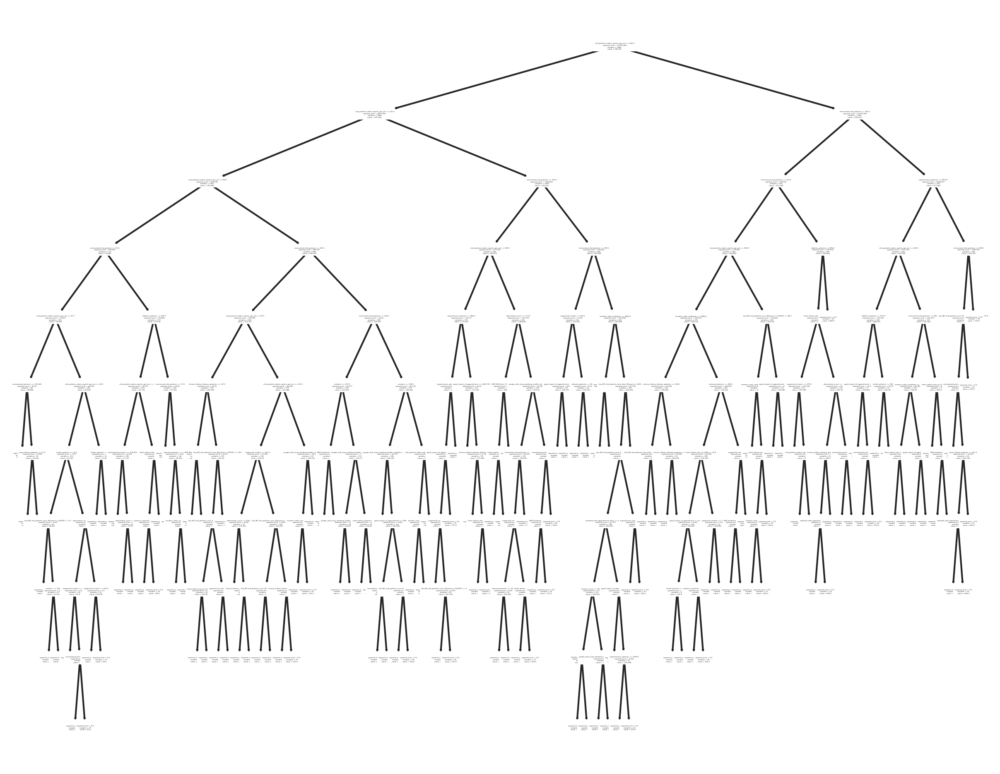

In [41]:
plt.figure(figsize=(10,8), dpi=150)
plot_tree(model, feature_names=X.columns);

In [ ]:
#Decision tree model
dt = DecisionTreeRegressor(random_state= 44)
dt.fit(X_train, y_train)

DecisionTreeRegressor(random_state=44)

In [ ]:
#Making predictions with Decision tree
y_prediction = dt.predict(X_test)
y_prediction[:5]

array([101., 363., 131.,  88., 133.])

In [ ]:
#Evaluating the model

#Mean absolute error
mae_dt = mean_absolute_error(y_test, y_prediction)
mae_dt

0.0

In [ ]:
r2_dt = r2_score(y_test,y_prediction)
r2_dt

1.0

In [ ]:
mse_dt = mean_squared_error(y_test,y_prediction)
mse_dt

0.0

## Predicting stroke


In [ ]:
df_stroke = merged.copy()

In [ ]:
df_stroke.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5920 entries, 0 to 5919
Data columns (total 48 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   deprivation_score                                 5920 non-null   float64
 1   positive_experience                               5920 non-null   float64
 2   good_report_of_appointment                        5920 non-null   float64
 3   unemployed_persons                                5920 non-null   float64
 4   satisfied_with_appointment times                  5920 non-null   float64
 5   people_with_long_standing_health_condition        5920 non-null   float64
 6    chd_patients_taken_aspirin_apt_act               5920 non-null   float64
 7   heart_failure_due_to_LVSD                         5920 non-null   float64
 8   heart_failure_patients                            5920 non-null   float64
 9   last_BP_chd_patient

In [ ]:
#Renaming the stroke column to y 
df_stroke.rename(columns = {'y':'chd_patients'}, inplace = True)

In [ ]:
df_stroke.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5920 entries, 0 to 5919
Data columns (total 48 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   deprivation_score                                 5920 non-null   float64
 1   positive_experience                               5920 non-null   float64
 2   good_report_of_appointment                        5920 non-null   float64
 3   unemployed_persons                                5920 non-null   float64
 4   satisfied_with_appointment times                  5920 non-null   float64
 5   people_with_long_standing_health_condition        5920 non-null   float64
 6    chd_patients_taken_aspirin_apt_act               5920 non-null   float64
 7   heart_failure_due_to_LVSD                         5920 non-null   float64
 8   heart_failure_patients                            5920 non-null   float64
 9   last_BP_chd_patient

In [ ]:
#Renaming stroke patients column to y
df_stroke.rename(columns = {'stroke_patients':'y'}, inplace = True)

In [ ]:
#Splitting dataset using the merged dataset in the chd prediction
X = df_stroke.loc[:, df_stroke.columns != 'y']
y = df_stroke.loc[:, df_stroke.columns == 'y']

In [ ]:
#Linear Regression for Stroke
lin = LinearRegression()
lin

In [ ]:
#Splitting the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [ ]:
#Using standard scaler
pi = Pipeline([ ('scaler',StandardScaler()),
                     ('model',Lasso())])

In [ ]:
sch = GridSearchCV(pi,
                      {'model__alpha':np.arange(0.1,10,0.1)},
                      cv = 5, scoring="neg_mean_squared_error",verbose=3
                      )
#Scaling the varibles
sch.fit(X_train,y_train)

Fitting 5 folds for each of 99 candidates, totalling 495 fits
[CV 1/5] END ...............model__alpha=0.1;, score=-264.118 total time=   0.1s
[CV 2/5] END ...............model__alpha=0.1;, score=-283.421 total time=   0.2s
[CV 3/5] END ...............model__alpha=0.1;, score=-283.715 total time=   0.2s
[CV 4/5] END ...............model__alpha=0.1;, score=-306.715 total time=   0.2s
[CV 5/5] END ...............model__alpha=0.1;, score=-281.332 total time=   0.1s
[CV 1/5] END ...............model__alpha=0.2;, score=-291.455 total time=   0.1s
[CV 2/5] END ...............model__alpha=0.2;, score=-309.139 total time=   0.2s
[CV 3/5] END ...............model__alpha=0.2;, score=-315.197 total time=   0.2s
[CV 4/5] END ...............model__alpha=0.2;, score=-341.408 total time=   0.2s
[CV 5/5] END ...............model__alpha=0.2;, score=-312.135 total time=   0.1s
[CV 1/5] END model__alpha=0.30000000000000004;, score=-300.702 total time=   0.1s
[CV 2/5] END model__alpha=0.30000000000000004;

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('model', Lasso())]),
             param_grid={'model__alpha': array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2, 1.3,
       1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2, 2.3, 2.4, 2.5, 2.6,
       2.7, 2.8, 2.9, 3. , 3.1, 3.2, 3.3, 3.4, 3.5, 3.6, 3.7, 3.8, 3.9,
       4. , 4.1, 4.2, 4.3, 4.4, 4.5, 4.6, 4.7, 4.8, 4.9, 5. , 5.1, 5.2,
       5.3, 5.4, 5.5, 5.6, 5.7, 5.8, 5.9, 6. , 6.1, 6.2, 6.3, 6.4, 6.5,
       6.6, 6.7, 6.8, 6.9, 7. , 7.1, 7.2, 7.3, 7.4, 7.5, 7.6, 7.7, 7.8,
       7.9, 8. , 8.1, 8.2, 8.3, 8.4, 8.5, 8.6, 8.7, 8.8, 8.9, 9. , 9.1,
       9.2, 9.3, 9.4, 9.5, 9.6, 9.7, 9.8, 9.9])},
             scoring='neg_mean_squared_error', verbose=3)

In [ ]:
sch.best_params_
coef = sch.best_estimator_.named_steps['model'].coef_
imp = np.abs(coef)

#Extracting the features with best features
F = pd.DataFrame(df_stroke.loc[:, df_stroke.columns != 'y'])
important_features = F.columns
np.array(important_features)[imp > 0]


array(['positive_experience', 'good_report_of_appointment',
       'unemployed_persons', 'satisfied_with_appointment times',
       'people_with_long_standing_health_condition',
       ' chd_patients_taken_aspirin_apt_act', 'heart_failure_due_to_LVSD',
       'heart_failure_patients',
       'last_BP_chd_patients_less_than_80years(<=140/90)',
       'last_BP_chd_patients_over_80years(<=150/90)',
       'immunised_chd_patients', 'chronic_kidney_disease_patients',
       'diabetic_patients', 'smokers', 'hypertensive_patients',
       ' supported_smoker', 'smokers_with_conditions', 'obessed_patients',
       'Gender_count', 'NHS Basildon And Brentwood CCG',
       'NHS Mid Essex CCG', 'NHS Thurrock CCG', '0_4', '30_34', '40_44',
       '50_54', '5_9', '65_69', '70_74', '85_89', '95+', 'females'],
      dtype=object)

In [ ]:
#Extracting the features with least features
F = pd.DataFrame(df_stroke.loc[:, df_stroke.columns != 'y'])
important_features = F.columns
np.array(important_features)[imp == 0]


array(['deprivation_score', 'chd_patients', 'NHS Southend CCG', '10_14',
       '15_19', '20_24', '25_29', '35_39', '45_49', '55_59', '60_64',
       '75_79', '80_84', '90_94', 'males'], dtype=object)

In [ ]:
lin.fit(X_train, y_train)
y_predict = lin.predict(X_test)
print("R squared value of the linear Regression model of the test: {:.2f}".format(r2_score(y_test, y_predict)))
print("Linear Regression MSE of the test set is: {:.2f}".format(mean_squared_error(y_test, y_predict)))
print("Linear Regression MAE of the test set is: {:.2f}".format(mean_absolute_error(y_test, y_predict)))

R squared value of the linear Regression model of the test: 0.98
Linear Regression MSE of the test set is: 267.48
Linear Regression MAE of the test set is: 12.67


Text(0, 0.5, 'Predicted number of stroke patients')

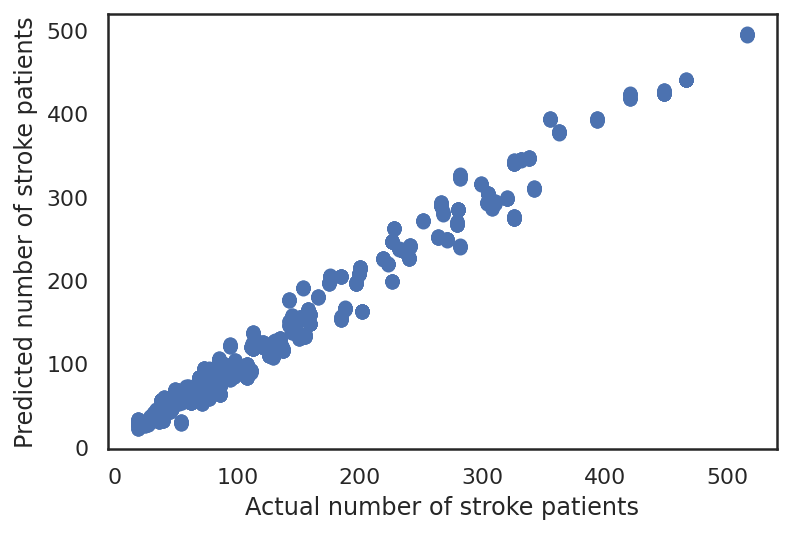

In [ ]:
prediction = lin.predict(X_test)
plt.scatter(y_test, prediction)
plt.xlabel('Actual number of stroke patients')
plt.ylabel('Predicted number of stroke patients')




In [ ]:
coeff_df = pd.DataFrame(X_train.columns.delete(0))
coeff_df.columns = ['Feature']
coeff_df["Correlation"] = pd.Series(lin.coef_[0])

coeff_df.sort_values(by='Correlation', ascending=False)

,Feature,Correlation
24,0_4,5.753916
21,NHS Mid Essex CCG,3.787285
42,90_94,0.879383
10,immunised_chd_patients,0.844133
32,45_49,0.725619
31,40_44,0.642889
38,70_74,0.621256
23,NHS Thurrock CCG,0.503994
6,heart_failure_due_to_LVSD,0.475946
33,50_54,0.410433


## Decision Tree Model for Stroke prediction

---




In [ ]:
#Splitting dataset
X = df_stroke.loc[:, df_stroke.columns != 'y']
y = df_stroke.loc[:, df_stroke.columns == 'y']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [ ]:
#Decision tree model
dt = DecisionTreeRegressor(random_state= 44)
dt.fit(X_train, y_train)

DecisionTreeRegressor(random_state=44)

In [ ]:
#Evaluating the model
y_prediction = dt.predict(X_test)
#Mean absolute error
mae_dt = mean_absolute_error(y_test, y_prediction)
print(f'The mean absolue error for decision tree is {mae_dt}' )
r2_dt = r2_score(y_test,y_prediction)
print(f'The r squared value for decision tree is {r2_dt}')
mse_dt = mean_squared_error(y_test,y_prediction)
print(f'The mean squared error for decision tree is {mse_dt}')

The mean absolue error for decision tree is 0.0
The r squared value for decision tree is 1.0
The mean squared error for decision tree is 0.0


## Heart_failure


In [ ]:
df_hf = merged.copy()

In [ ]:
#Renaming the heart failure column to y 
df_hf.rename(columns = {'y':'chd_patients'}, inplace = True)
df_hf.rename(columns = {'heart_failure_patients':'y'}, inplace = True)

In [ ]:
df_hf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5920 entries, 0 to 5919
Data columns (total 48 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   deprivation_score                                 5920 non-null   float64
 1   positive_experience                               5920 non-null   float64
 2   good_report_of_appointment                        5920 non-null   float64
 3   unemployed_persons                                5920 non-null   float64
 4   satisfied_with_appointment times                  5920 non-null   float64
 5   people_with_long_standing_health_condition        5920 non-null   float64
 6    chd_patients_taken_aspirin_apt_act               5920 non-null   float64
 7   heart_failure_due_to_LVSD                         5920 non-null   float64
 8   heart_failure_patients                            5920 non-null   float64
 9   last_BP_chd_patient

In [ ]:
#Splitting dataset using the merged dataset in the chd prediction
X = df_hf.loc[:, df_hf.columns != 'y']
y = df_hf.loc[:, df_hf.columns == 'y']

In [ ]:
#Splitting the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [ ]:
#Using standard scaler
pi = Pipeline([ ('scaler',StandardScaler()),
                     ('model',Lasso())])

In [ ]:
sch = GridSearchCV(pi,
                      {'model__alpha':np.arange(0.1,10,0.1)},
                      cv = 5, scoring="neg_mean_squared_error",verbose=3
                      )
#Scaling the varibles
sch.fit(X_train,y_train)

Fitting 5 folds for each of 99 candidates, totalling 495 fits
[CV 1/5] END ...............model__alpha=0.1;, score=-158.906 total time=   0.1s
[CV 2/5] END ...............model__alpha=0.1;, score=-159.152 total time=   0.1s
[CV 3/5] END ...............model__alpha=0.1;, score=-147.920 total time=   0.1s
[CV 4/5] END ...............model__alpha=0.1;, score=-142.786 total time=   0.1s
[CV 5/5] END ...............model__alpha=0.1;, score=-146.429 total time=   0.1s
[CV 1/5] END ...............model__alpha=0.2;, score=-169.841 total time=   0.1s
[CV 2/5] END ...............model__alpha=0.2;, score=-168.838 total time=   0.1s
[CV 3/5] END ...............model__alpha=0.2;, score=-156.811 total time=   0.1s
[CV 4/5] END ...............model__alpha=0.2;, score=-149.918 total time=   0.1s
[CV 5/5] END ...............model__alpha=0.2;, score=-157.192 total time=   0.1s
[CV 1/5] END model__alpha=0.30000000000000004;, score=-172.822 total time=   0.1s
[CV 2/5] END model__alpha=0.30000000000000004;

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('model', Lasso())]),
             param_grid={'model__alpha': array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2, 1.3,
       1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2, 2.3, 2.4, 2.5, 2.6,
       2.7, 2.8, 2.9, 3. , 3.1, 3.2, 3.3, 3.4, 3.5, 3.6, 3.7, 3.8, 3.9,
       4. , 4.1, 4.2, 4.3, 4.4, 4.5, 4.6, 4.7, 4.8, 4.9, 5. , 5.1, 5.2,
       5.3, 5.4, 5.5, 5.6, 5.7, 5.8, 5.9, 6. , 6.1, 6.2, 6.3, 6.4, 6.5,
       6.6, 6.7, 6.8, 6.9, 7. , 7.1, 7.2, 7.3, 7.4, 7.5, 7.6, 7.7, 7.8,
       7.9, 8. , 8.1, 8.2, 8.3, 8.4, 8.5, 8.6, 8.7, 8.8, 8.9, 9. , 9.1,
       9.2, 9.3, 9.4, 9.5, 9.6, 9.7, 9.8, 9.9])},
             scoring='neg_mean_squared_error', verbose=3)

In [ ]:
sch.best_params_
coef = sch.best_estimator_.named_steps['model'].coef_
imp = np.abs(coef)

#Extracting the features with best features
F = pd.DataFrame(df_hf.loc[:, df_hf.columns != 'y'])
important_features = F.columns
np.array(important_features)[imp > 0]


array(['deprivation_score', 'positive_experience', 'unemployed_persons',
       'satisfied_with_appointment times',
       'people_with_long_standing_health_condition',
       'heart_failure_due_to_LVSD',
       'last_BP_chd_patients_less_than_80years(<=140/90)',
       'chronic_kidney_disease_patients', 'diabetic_patients', 'smokers',
       'hypertensive_patients', 'obessed_patients', 'chd_patients',
       'stroke_patients', 'Gender_count', 'NHS Mid Essex CCG',
       'NHS Southend CCG', 'NHS Thurrock CCG', '10_14', '20_24', '40_44',
       '55_59', '5_9', '75_79', '95+', 'females'], dtype=object)

In [ ]:
#Extracting the  least features in predicting heart failure
F = pd.DataFrame(df_hf.loc[:, df_hf.columns != 'y'])
important_features = F.columns
np.array(important_features)[imp == 0]


array(['good_report_of_appointment',
       ' chd_patients_taken_aspirin_apt_act',
       'last_BP_chd_patients_over_80years(<=150/90)',
       'immunised_chd_patients', ' supported_smoker',
       'smokers_with_conditions', 'NHS Basildon And Brentwood CCG', '0_4',
       '15_19', '25_29', '30_34', '35_39', '45_49', '50_54', '60_64',
       '65_69', '70_74', '80_84', '85_89', '90_94', 'males'], dtype=object)

# Risk Dataset

In [ ]:
#Loading risk data 
df2 = pd.read_excel('/content/cardio_data.xlsx', 'Copy of Risk Trend Data')
df2.head()

,Indicator Name,CCG Code,CCG Name,GP Code,GP Name,Age,Time period,percentage_value,Count,population,Year
0,smokers_with_conditions,E38000106,NHS Mid Essex CCG,F81665,Chelmer Village Surgery,All ages,2013/14,93.724420,687.0,733.0,2013
1,patients_with_CKD,E38000007,NHS Basildon And Brentwood CCG,F81085,"Dr A Naeem & Partners,The New Surgery",18+ yrs,2017/18,4.201987,461.0,10971.0,2017
2,chd_patients,E38000106,NHS Mid Essex CCG,F81149,The Laurels Surgery,All ages,2018/19,3.705732,406.0,10956.0,2018
3,smokers,E38000185,NHS Thurrock CCG,F81641,Milton Road Surgery,15+ yrs,2017/18,20.572019,597.0,2902.0,2017
4,chd_patients,E38000106,NHS Mid Essex CCG,F81665,Chelmer Village Surgery,All ages,2020/21,2.258202,106.0,4694.0,2020


In [ ]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23715 entries, 0 to 23714
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Indicator Name    23715 non-null  object 
 1   CCG Code          23715 non-null  object 
 2   CCG Name          23715 non-null  object 
 3   GP Code           23715 non-null  object 
 4   GP Name           23715 non-null  object 
 5   Age               23715 non-null  object 
 6   Time period       23715 non-null  object 
 7   percentage_value  23493 non-null  float64
 8   Count             23373 non-null  float64
 9   population        23343 non-null  float64
 10  Year              23715 non-null  float64
dtypes: float64(4), object(7)
memory usage: 2.0+ MB


In [ ]:
df2['Count'].value_counts()

1.0       305
2.0       234
3.0       187
5.0       166
4.0       146
         ... 
2037.0      1
3909.0      1
4721.0      1
3969.0      1
5474.0      1
Name: Count, Length: 3083, dtype: int64

In [ ]:
df2.isnull().sum()

Indicator Name          0
CCG Code                0
CCG Name                0
GP Code                 0
GP Name                 0
Age                     0
Time period             0
percentage_value      222
Count                 342
population            372
Year                    0
                    23715
 .1                 23715
 .2                 23715
 .3                 23715
 .4                 23715
dtype: int64

In [ ]:
df2['Indicator Name'].value_counts()

patients_with_heart_failure                                                                                         1791
chd_patients                                                                                                        1791
diabetic_patients                                                                                                   1791
stroke_patients                                                                                                     1791
hypertensive_patients                                                                                               1791
patients_with_CKD                                                                                                   1642
smokers_with_conditions                                                                                             1346
supported_smokers                                                                                                   1346
chd_patents_aspirin_taken       

In [ ]:
df2.shape

(23715, 11)

**Questions**

- What year has the highest recorded CHD patients


In [ ]:
#Separating the catgorical data in the indicator name column to separate dataframes  that would be merged 
chd = df2[df2['Indicator Name'] == 'chd_patients']
heartf_df = df2[df2['Indicator Name'] == 'patients_with_heart_failure']
diab_df = df2[df2['Indicator Name'] == 'diabetic_patients']
stroke_df = df2[df2['Indicator Name'] == 'stroke_patients']
hyp_df = df2[df2['Indicator Name'] == 'hypertensive_patients']
ckd_df = df2[df2['Indicator Name'] == 'patients_with_CKD']
smk_con_df = df2[df2['Indicator Name'] == 'smokers_with_conditions']
sup_smk_df = df2[df2['Indicator Name'] == 'supported_smokers']
chd_asp_df = df2[df2['Indicator Name'] == 'chd_patents_aspirin_taken']
imm_chd = df2[df2['Indicator Name'] == 'immunized_chd_patients']
smokers = df2[df2['Indicator Name'] == 'smokers']
hf_LVSD = df2[df2['Indicator Name'] == 'heart_failure_with_LVSD']
hpc = df2[df2['Indicator Name'] == 'hypertensive_patients_with_CV_risk']
a_f = hpc = df2[df2['Indicator Name'] == 'atrial_fibrillation']

In [ ]:
#Renaming the count and percentage values in the new data frames
chd.rename(columns = {'Count':'chd_count', 'percentage_value':'chd_percent'}, inplace = True)
heartf_df.rename(columns = {'Count':'heart_failure_count', 'percentage_value':'heart_failure_percent'}, inplace = True)
diab_df.rename(columns = {'Count':'diabetic_count', 'percentage_value':'diabetic_percent'}, inplace = True)
stroke_df.rename(columns = {'Count':'stroke_count', 'percentage_value':'stroke_percent'}, inplace = True)
hyp_df.rename(columns = {'Count':'hypertensive_count', 'percentage_value':'hypertensive_percent'}, inplace = True)
ckd_df.rename(columns = {'Count':'ckd_count', 'percentage_value':'ckd_percent'}, inplace = True)
smk_con_df.rename(columns = {'Count':'smoker_with_cond_count', 'percentage_value':'smoker_with_cond_percent'}, inplace = True)
sup_smk_df.rename(columns = {'Count':'supported_smoker_count', 'percentage_value':'supported_smoker_percent'}, inplace = True)
chd_asp_df.rename(columns = {'Count':'chd_aspirin_count', 'percentage_value':'chd_aspirin_percent'}, inplace = True)
imm_chd.rename(columns = {'Count':'immunised_chd_count', 'percentage_value':'immunised_chd_percent'}, inplace = True)
smokers.rename(columns = {'Count':'smokers_count', 'percentage_value':'smokers_percent'}, inplace = True)
hf_LVSD.rename(columns = {'Count':'heartfailure_lvsd_count', 'percentage_value':'heartfailure_lvsd_percent'}, inplace = True)
hpc.rename(columns = {'Count':'hyp_pts_cvrisk__count', 'percentage_value':'hyp_pts_cvrisk_percent'}, inplace = True)
a_f.rename(columns = {'Count':'atrial_fib_count', 'percentage_value':'atrial_fib_percent'}, inplace = True)



/usr/local/lib/python3.8/dist-packages/pandas/core/frame.py:5039: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df_m = df2.copy()
df_m.head()

,Indicator Name,CCG Code,CCG Name,GP Code,GP Name,Age,Time period,percentage_value,Count,population,Year
0,smokers_with_conditions,E38000106,NHS Mid Essex CCG,F81665,Chelmer Village Surgery,All ages,2013/14,93.724420,687.0,733.0,2013
1,patients_with_CKD,E38000007,NHS Basildon And Brentwood CCG,F81085,"Dr A Naeem & Partners,The New Surgery",18+ yrs,2017/18,4.201987,461.0,10971.0,2017
2,chd_patients,E38000106,NHS Mid Essex CCG,F81149,The Laurels Surgery,All ages,2018/19,3.705732,406.0,10956.0,2018
3,smokers,E38000185,NHS Thurrock CCG,F81641,Milton Road Surgery,15+ yrs,2017/18,20.572019,597.0,2902.0,2017
4,chd_patients,E38000106,NHS Mid Essex CCG,F81665,Chelmer Village Surgery,All ages,2020/21,2.258202,106.0,4694.0,2020


In [ ]:
cols=['Age', 'CCG Code', 'Indicator Name', 'population']
df_m.drop(columns =cols, inplace = True)
chd.drop(columns = cols, inplace = True)
heartf_df.drop(columns = cols, inplace = True)
diab_df.drop(columns = cols, inplace = True)
stroke_df.drop(columns = cols, inplace = True)
hyp_df.drop(columns = cols, inplace = True)
ckd_df.drop(columns = cols, inplace = True)
smk_con_df.drop(columns = cols, inplace = True)
sup_smk_df.drop(columns = cols, inplace = True)
chd_asp_df.drop(columns = cols, inplace = True)
imm_chd.drop(columns = cols, inplace = True)
hf_LVSD.drop(columns = cols, inplace = True)
smokers.drop(columns = cols, inplace = True)
hpc.drop(columns = cols, inplace = True)
#a_f.drop(columns = cols, inplace = True)



/usr/local/lib/python3.8/dist-packages/pandas/core/frame.py:4906: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
one = pd.merge(df_m, chd, how='inner')
#list1 =[smokers, a_f, imm_chd, sup_smk_df, heartf_df, diab_df, stroke_df,\
        #hyp_df, ckd_df, smk_con_df, chd_asp_df, hf_LVSD, hpc ]

     

In [ ]:
one.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23715 entries, 0 to 23714
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   CCG Name          23715 non-null  object 
 1   GP Code           23715 non-null  object 
 2   GP Name           23715 non-null  object 
 3   Time period       23715 non-null  object 
 4   percentage_value  23493 non-null  float64
 5   Count             23373 non-null  float64
 6   Year              23715 non-null  int64  
 7   chd_percent       23715 non-null  float64
 8   chd_count         23715 non-null  float64
dtypes: float64(4), int64(1), object(4)
memory usage: 1.8+ MB


In [ ]:
#Merging the CHD data with the heart data
two = pd.merge(one, heartf_df, how = 'inner')
two.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23715 entries, 0 to 23714
Data columns (total 11 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   CCG Name               23715 non-null  object 
 1   GP Code                23715 non-null  object 
 2   GP Name                23715 non-null  object 
 3   Time period            23715 non-null  object 
 4   percentage_value       23493 non-null  float64
 5   Count                  23373 non-null  float64
 6   Year                   23715 non-null  int64  
 7   chd_percent            23715 non-null  float64
 8   chd_count              23715 non-null  float64
 9   heart_failure_percent  23715 non-null  float64
 10  heart_failure_count    23715 non-null  float64
dtypes: float64(6), int64(1), object(4)
memory usage: 2.2+ MB


In [ ]:
two['Year'].value_counts()

2019    3000
2020    2550
2015    2388
2014    2384
2017    2250
2013    2235
2018    2235
2016    2217
2012    1341
2011    1043
2010    1043
2009    1029
Name: Year, dtype: int64

In [ ]:
#Creating a function to merge the dataframes
def datamerge(df1, df2):
  df = pd.merge(df1, df2, how = 'inner')
  return df

In [ ]:
three = pd.merge(two, smokers, how = 'inner')

In [ ]:
three['Year'].value_counts()

2019    3000
2020    2550
2015    2388
2014    2384
2017    2250
2013    2235
2018    2235
2016    2217
Name: Year, dtype: int64

In [ ]:
#list1 =[smokers, a_f, imm_chd, sup_smk_df, heartf_df, diab_df, stroke_df,\
        #hyp_df, ckd_df, smk_con_df, chd_asp_df, hf_LVSD, hpc ]


In [ ]:
three = datamerge(two, smokers)
four = datamerge(three, a_f)
five = datamerge(four, imm_chd)
six = datamerge(five, sup_smk_df)
seven = datamerge(six, diab_df)
eight = datamerge(seven, stroke_df)
nine = datamerge(eight, hyp_df)
ten = datamerge(nine, ckd_df)
eleven = datamerge(ten, smk_con_df)
twelve = datamerge(eleven, chd_asp_df)
thirteen = datamerge(twelve, hf_LVSD )
complete = datamerge(thirteen, hpc )


In [ ]:
complete.head()

,CCG Name,GP Code,GP Name,Time period,percentage_value,Count,Year,chd_percent,chd_count,heart_failure_percent,...,hypertensive_percent,hypertensive_count,ckd_percent,ckd_count,smoker_with_cond_percent,smoker_with_cond_count,chd_aspirin_percent,chd_aspirin_count,heartfailure_lvsd_percent,heartfailure_lvsd_count
0,NHS Southend CCG,F81713,Benfleet Surgery,2015/16,14.920194,430.0,2015,1.564683,56.0,0.307348,...,9.86309,353.0,1.140125,31.0,93.90681,524.0,94.642857,53.0,100.0,1.0
1,NHS Southend CCG,F81713,Benfleet Surgery,2015/16,100.000000,10.0,2015,1.564683,56.0,0.307348,...,9.86309,353.0,1.140125,31.0,93.90681,524.0,94.642857,53.0,100.0,1.0
2,NHS Southend CCG,F81713,Benfleet Surgery,2015/16,100.000000,1.0,2015,1.564683,56.0,0.307348,...,9.86309,353.0,1.140125,31.0,93.90681,524.0,94.642857,53.0,100.0,1.0
3,NHS Southend CCG,F81713,Benfleet Surgery,2015/16,100.000000,1.0,2015,1.564683,56.0,0.307348,...,9.86309,353.0,1.140125,31.0,93.90681,524.0,94.642857,53.0,100.0,1.0
4,NHS Southend CCG,F81713,Benfleet Surgery,2015/16,94.642857,53.0,2015,1.564683,56.0,0.307348,...,9.86309,353.0,1.140125,31.0,93.90681,524.0,94.642857,53.0,100.0,1.0


In [ ]:
#Geting the maximum stroke patients yearly
a = pd.DataFrame (time.groupby('Year')['stroke_percent'].aggregate('max'))
a

,stroke_percent
Year,
2009.0,18.803419
2010.0,3.618421
2011.0,3.295990
2012.0,3.444976
2013.0,3.359338
2014.0,3.549287
2015.0,3.281853
2016.0,3.489284
2017.0,3.444287


In [ ]:
complete.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4592 entries, 0 to 4591
Data columns (total 33 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   CCG Name                   4592 non-null   object 
 1   GP Code                    4592 non-null   object 
 2   GP Name                    4592 non-null   object 
 3   Time period                4592 non-null   object 
 4   percentage_value           4565 non-null   float64
 5   Count                      4592 non-null   float64
 6   Year                       4592 non-null   int64  
 7   chd_percent                4592 non-null   float64
 8   chd_count                  4592 non-null   float64
 9   heart_failure_percent      4592 non-null   float64
 10  heart_failure_count        4592 non-null   float64
 11  smokers_percent            4592 non-null   float64
 12  smokers_count              4592 non-null   float64
 13  hyp_pts_cvrisk_percent     4592 non-null   float

In [ ]:
# Dropping the count and percentage value since it has been splitted for each indicator
complete.drop(columns = ['Count', 'percentage_value'], inplace = True)

In [ ]:
#Checking thw missing values after 
complete.isna().sum()

CCG Name                      0
GP Code                       0
GP Name                       0
Time period                   0
Year                          0
chd_percent                   0
chd_count                     0
heart_failure_percent         0
heart_failure_count           0
smokers_percent               0
smokers_count                 0
hyp_pts_cvrisk_percent        0
hyp_pts_cvrisk__count         0
immunised_chd_percent         0
immunised_chd_count           0
supported_smoker_percent      0
supported_smoker_count        0
diabetic_percent              0
diabetic_count                0
stroke_percent                0
stroke_count                  0
hypertensive_percent          0
hypertensive_count            0
ckd_percent                   0
ckd_count                     0
smoker_with_cond_percent      0
smoker_with_cond_count        0
chd_aspirin_percent           0
chd_aspirin_count             0
heartfailure_lvsd_percent    16
heartfailure_lvsd_count       0
dtype: i

In [ ]:
complete.to_csv('merged_data.csv')

In [ ]:
complete.duplicated().sum()

4305

In [ ]:
complete.drop_duplicates(inplace = True)

In [ ]:
complete.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 287 entries, 0 to 4576
Data columns (total 31 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   CCG Name                   287 non-null    object 
 1   GP Code                    287 non-null    object 
 2   GP Name                    287 non-null    object 
 3   Time period                287 non-null    object 
 4   Year                       287 non-null    int64  
 5   chd_percent                287 non-null    float64
 6   chd_count                  287 non-null    float64
 7   heart_failure_percent      287 non-null    float64
 8   heart_failure_count        287 non-null    float64
 9   smokers_percent            287 non-null    float64
 10  smokers_count              287 non-null    float64
 11  hyp_pts_cvrisk_percent     287 non-null    float64
 12  hyp_pts_cvrisk__count      287 non-null    float64
 13  immunised_chd_percent      287 non-null    float6

In [ ]:
complete.groupby('Year')['chd_percent'].sum()

Year
2014    7559.961358
2015    6971.130856
Name: chd_percent, dtype: float64

In [ ]:
hf_value = heartf_df[['Year', 'heart_failure_percent']].copy()

In [ ]:
hf_yr = pd.DataFrame(hf_value.groupby('Year')['heart_failure_percent'].aggregate('max'))
hf_yr

,heart_failure_percent
Year,
2009.0,2.564103
2010.0,2.032728
2011.0,1.909438
2012.0,1.835373
2013.0,2.140845
2014.0,1.898734
2015.0,1.692308
2016.0,1.756885
2017.0,1.773551


In [ ]:
#Putting the maximum percentage of stroke patients into a list 
yr = [2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020]
st = [18.80, 3.62, 3.30, 3.44, 3.36, 3.55, 3.28, 3.49, 3.44, 3.43, 2.98, 3.08]
li = list(zip(yr, st))
#Creating a dataframe from the list
data =pd.DataFrame(li,columns=['Year','Percentage_of_stroke'])
#data.head()


data['Year']= pd.to_datetime(data['Year'], format='%Y')


In [ ]:
#Setting the year as the index to use for fbprophet
data.set_index('Year', inplace = True)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 12 entries, 2009-01-01 to 2020-01-01
Data columns (total 1 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Percentage_of_stroke  12 non-null     float64
dtypes: float64(1)
memory usage: 192.0 bytes


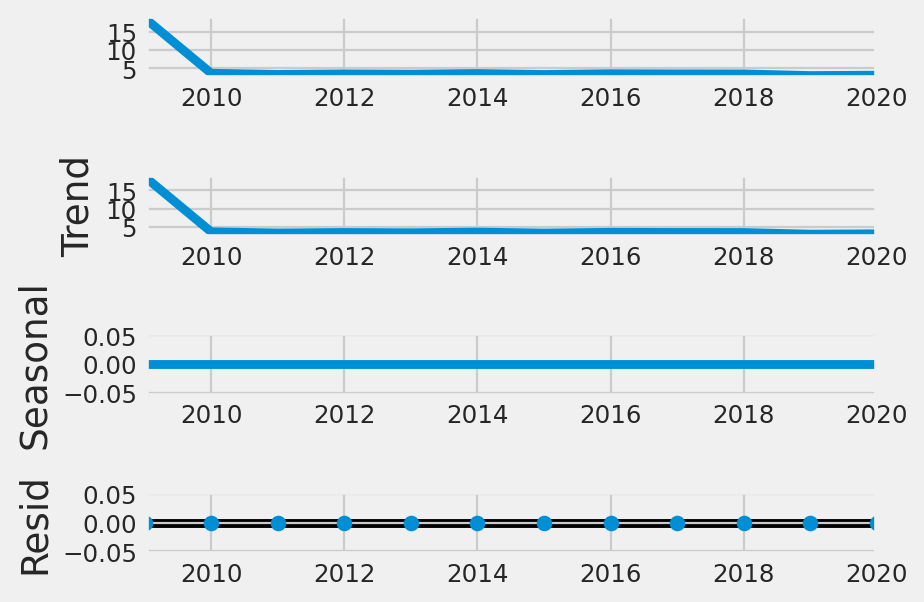

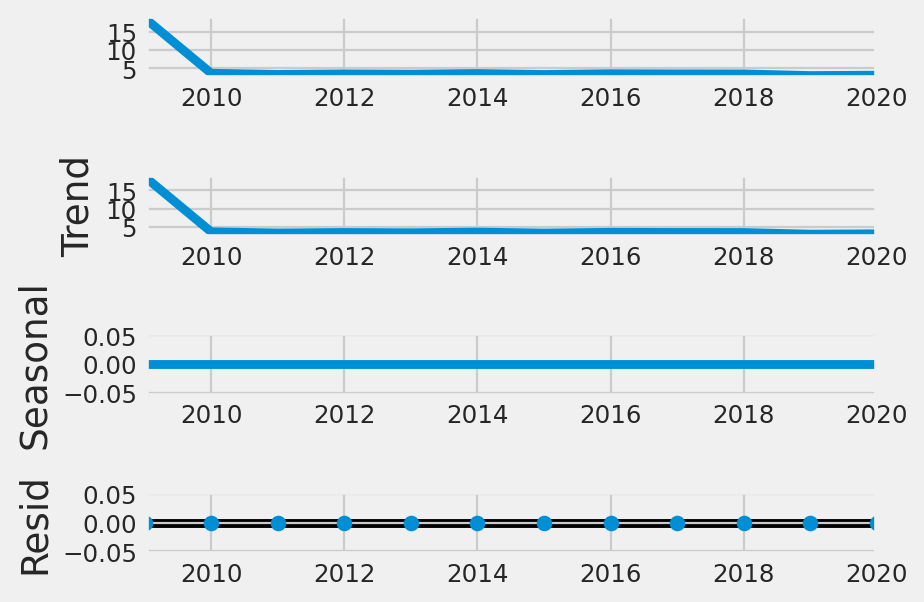

In [ ]:
de = sm.tsa.seasonal_decompose(data, model = 'additive')
de.plot()


In [ ]:
import statsmodels.api as sm

In [ ]:
m = Prophet()
model = m.fit(data)

ValueError: ignored

In [ ]:
fu = m.make_future_dataframe(periods = 2)
fore = m.predict(f)

Exception: ignored

In [ ]:
fore

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2009-01-01,3.640169,4.708044,13.696062,3.640169,3.640169,5.469926,5.469926,5.469926,5.469926,5.469926,5.469926,0.0,0.0,0.0,9.110095
1,2010-01-01,3.135539,3.246007,12.047029,3.135539,3.135539,4.304228,4.304228,4.304228,4.304228,4.304228,4.304228,0.0,0.0,0.0,7.439767
2,2011-01-01,2.630910,1.118690,10.236547,2.630910,2.630910,3.215412,3.215412,3.215412,3.215412,3.215412,3.215412,0.0,0.0,0.0,5.846322
3,2012-01-01,2.126280,-0.254992,8.726275,2.126280,2.126280,2.204798,2.204798,2.204798,2.204798,2.204798,2.204798,0.0,0.0,0.0,4.331078
4,2013-01-01,1.620268,2.534925,11.795267,1.620268,1.620268,5.469926,5.469926,5.469926,5.469926,5.469926,5.469926,0.0,0.0,0.0,7.090194
5,2014-01-01,1.115639,0.733452,9.663218,1.115639,1.115639,4.304228,4.304228,4.304228,4.304228,4.304228,4.304228,0.0,0.0,0.0,5.419867
6,2015-01-01,0.611009,-0.392892,8.435108,0.611009,0.611009,3.215412,3.215412,3.215412,3.215412,3.215412,3.215412,0.0,0.0,0.0,3.826421
7,2016-01-01,0.106380,-1.961683,6.873615,0.106380,0.106380,2.204798,2.204798,2.204798,2.204798,2.204798,2.204798,0.0,0.0,0.0,2.311178
8,2017-01-01,-0.399632,0.489575,9.405310,-0.399632,-0.399632,5.469926,5.469926,5.469926,5.469926,5.469926,5.469926,0.0,0.0,0.0,5.070294
9,2018-01-01,-0.904261,-1.141503,8.086288,-0.904261,-0.904261,4.304228,4.304228,4.304228,4.304228,4.304228,4.304228,0.0,0.0,0.0,3.399967


In [ ]:
#Confiming names has been changed successfuly before merging
chd.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1791 entries, 2 to 22314
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Indicator Name  1791 non-null   object 
 1   CCG Code        1791 non-null   object 
 2   CCG Name        1791 non-null   object 
 3   GP Code         1791 non-null   object 
 4   GP Name         1791 non-null   object 
 5   Age             1791 non-null   object 
 6   Time period     1791 non-null   object 
 7   chd_percent     1791 non-null   float64
 8   chd_count       1791 non-null   float64
 9   population      1791 non-null   float64
 10  Year            1791 non-null   float64
dtypes: float64(4), object(7)
memory usage: 167.9+ KB


In [ ]:
from prophet.plot import plot_plotly
import plotly.offline as py
py.init_notebook_mode()
plt.style.use('fivethirtyeight')

In [ ]:
a = pd.DataFrame (time.groupby('Year')['stroke_percent'].aggregate('max'))

## FB PROPHET MODEL

In [ ]:
#Extracting only year and count of stroke patients over the year
str_yr = stroke_df[['Year', 'stroke_count']].copy()
str_yr.groupby('Year')['stroke_count'].sum()

Year
2009    15498.0
2010    16214.0
2011    16711.0
2012    16763.0
2013    17183.0
2014    17623.0
2015    18329.0
2016    19122.0
2017    19722.0
2018    20671.0
2019    21981.0
2020    22186.0
Name: stroke_count, dtype: float64

In [ ]:
yr = [2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020]
st = [15498, 16214, 16711, 16763, 17183, 17623, 18329, 19122, 19722, 20671, 21981, 22186]
li = list(zip(yr, st))

data =pd.DataFrame(li,columns=['Year','stroke_count'])
#data.head()


data['Year']= pd.to_datetime(data['Year'], format='%Y')


In [ ]:
#Only towo columns are allowed in FB prophet and must be saved in ds and y
data = data.rename(columns={'Year': 'ds',
                        'stroke_count': 'y'})

data.head()

,ds,y
0,2009-01-01,15498
1,2010-01-01,16214
2,2011-01-01,16711
3,2012-01-01,16763
4,2013-01-01,17183


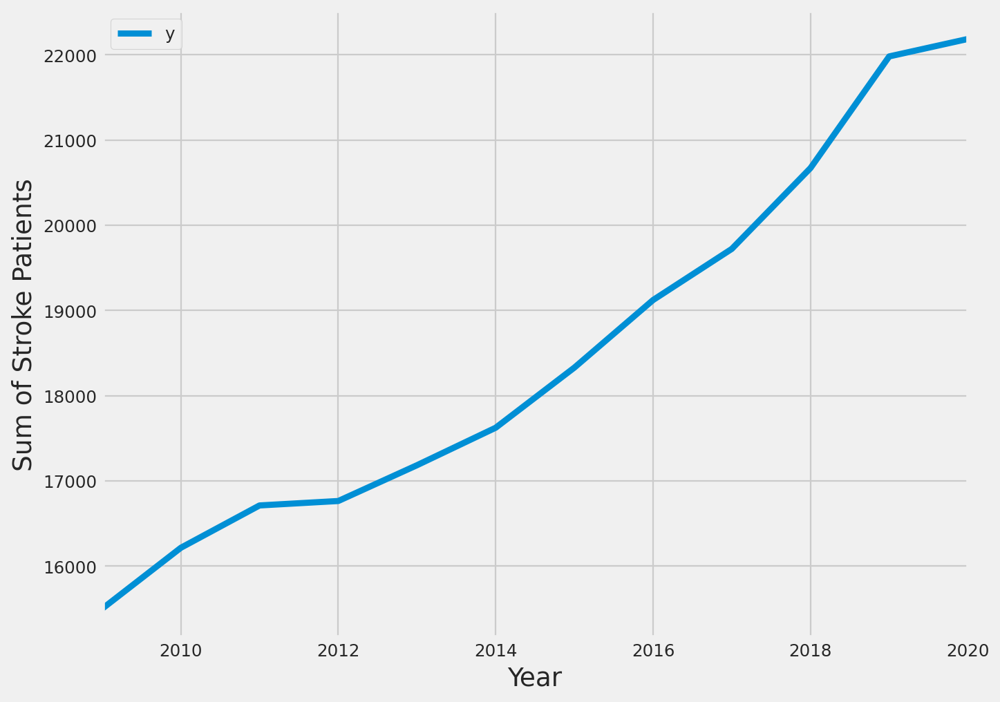

In [ ]:
ax = data.set_index('ds').plot(figsize=(9, 7))
ax.set_ylabel('Sum of Stroke Patients')
ax.set_xlabel('Year')

plt.show()

In [ ]:
#Using fb model and setting with as 95
m = Prophet(interval_width=0.95)

In [ ]:
m.fit(data)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpvxcm8dyq/u0rn5z60.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpvxcm8dyq/ykqlxqi7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.8/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88638', 'data', 'file=/tmp/tmpvxcm8dyq/u0rn5z60.json', 'init=/tmp/tmpvxcm8dyq/ykqlxqi7.json', 'output', 'file=/tmp/tmpvxcm8dyq/prophet_model4d7wzzqy/prophet_model-20221212075414.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
07:54:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
07:54:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cm

In [ ]:
f = m.make_future_dataframe(periods=96, freq='MS')
f.head()

,ds
0,2009-01-01
1,2010-01-01
2,2011-01-01
3,2012-01-01
4,2013-01-01


In [ ]:
fore = m.predict(f)
fore[[ 'yhat_lower','yhat', 'yhat_upper', 'ds']].head()

,yhat_lower,yhat,yhat_upper,ds
0,15290.182107,15528.047719,15783.159128,2009-01-01
1,15959.867742,16199.322710,16424.121815,2010-01-01
2,16385.968656,16629.944978,16859.629951,2011-01-01
3,16582.767832,16819.266423,17049.778085,2012-01-01
4,16815.156624,17070.383645,17308.112794,2013-01-01


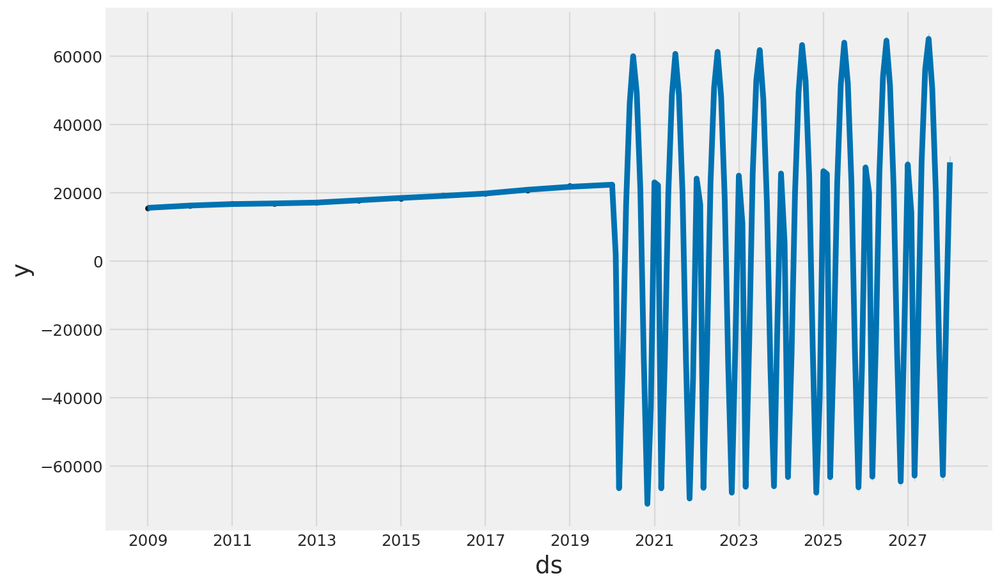

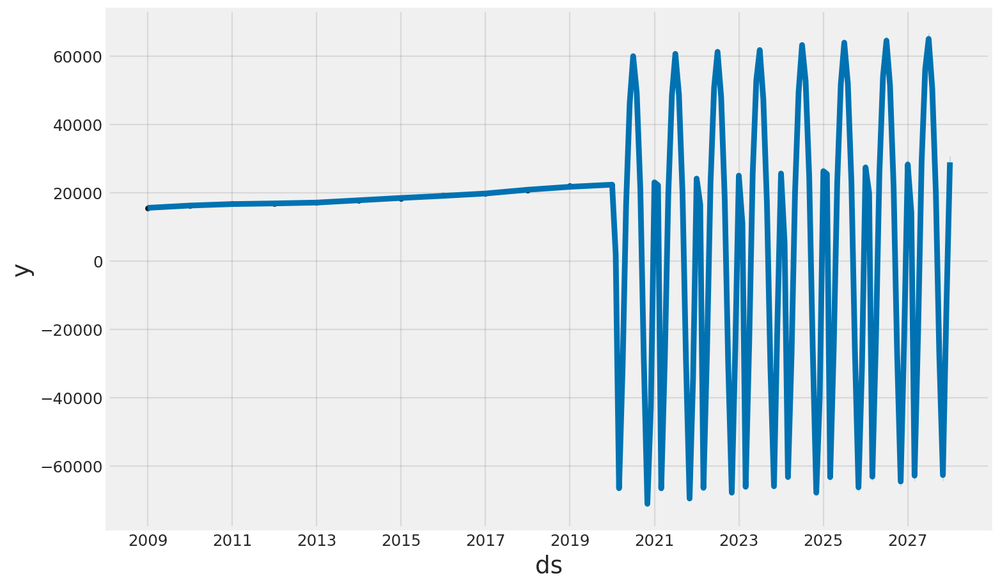

In [ ]:
m.plot(fore, uncertainty=True)

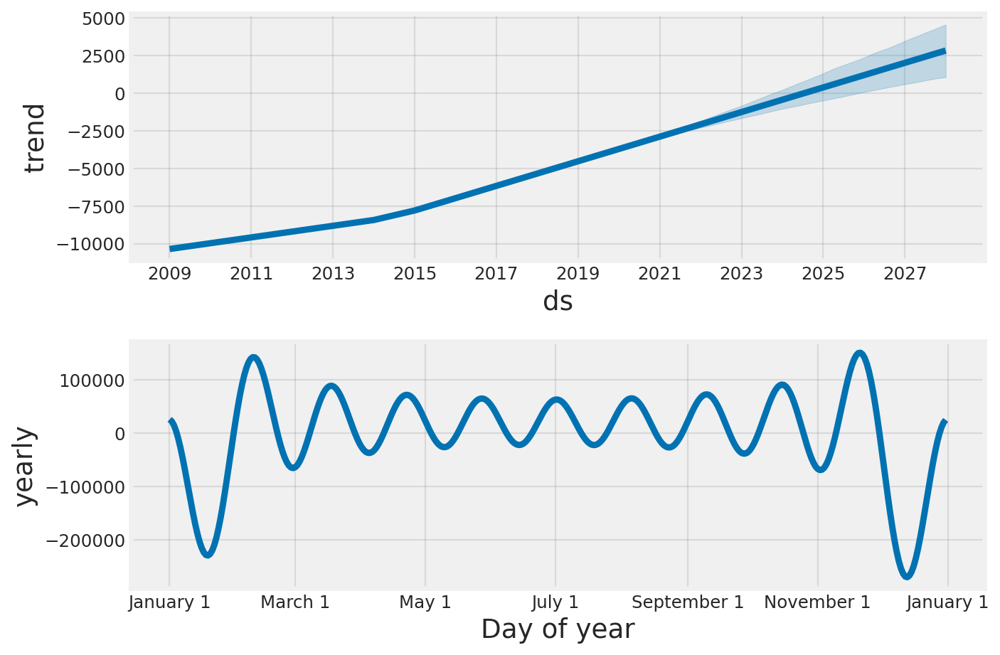

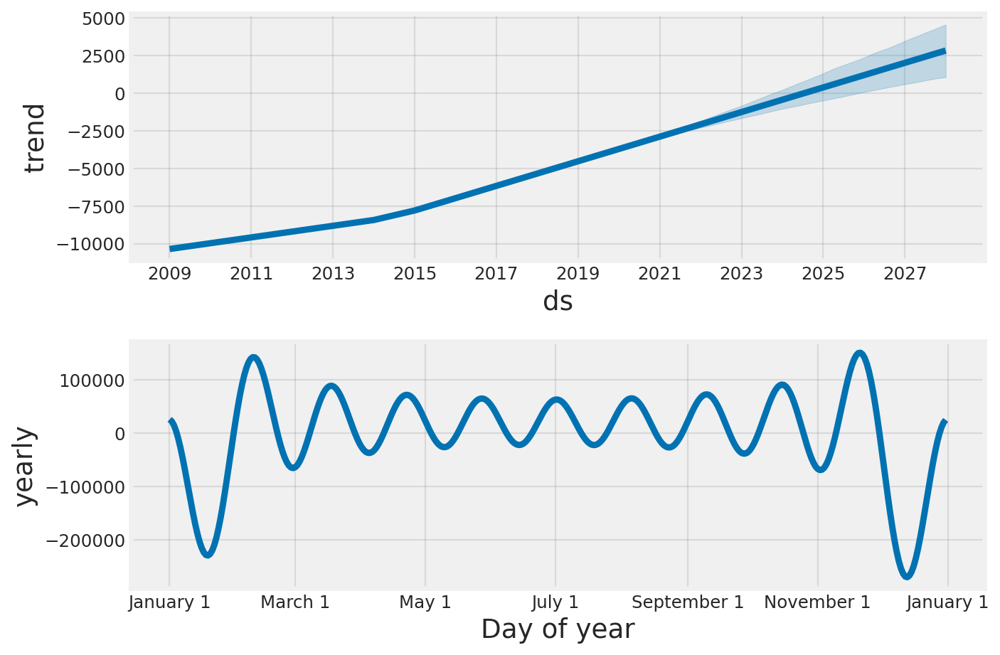

In [ ]:
m.plot_components(fore)

Using maximum percentage value of patients with stroke to forecast

In [ ]:
#Getting the stroke info
stroke_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1791 entries, 6 to 23285
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   CCG Name        1791 non-null   object 
 1   GP Code         1791 non-null   object 
 2   GP Name         1791 non-null   object 
 3   Time period     1791 non-null   object 
 4   stroke_percent  1791 non-null   float64
 5   stroke_count    1791 non-null   float64
 6   Year            1791 non-null   int64  
dtypes: float64(2), int64(1), object(4)
memory usage: 111.9+ KB


In [ ]:
#Extracting only year and count of stroke patients over the year
str_p = stroke_df[['Year', 'stroke_percent']].copy()
str_p.groupby('Year')['stroke_percent'].aggregate('max')

Year
2009    18.803419
2010     3.618421
2011     3.295990
2012     3.444976
2013     3.359338
2014     3.549287
2015     3.281853
2016     3.489284
2017     3.444287
2018     3.434189
2019     2.983371
2020     3.078939
Name: stroke_percent, dtype: float64

In [ ]:
#Saving values of stroke percent yearly
yr = [2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020]
st = [18.80, 3.62, 3.30, 3.44, 3.36, 3.55, 3.28, 3.49, 3.44, 3.43, 2.98, 3.08]
li = list(zip(yr, st))

df =pd.DataFrame(li,columns=['Year','Percentage_of_stroke'])
#data.head()


df['Year']= pd.to_datetime(df['Year'], format='%Y')

In [ ]:
#Renaming columns to ds and y
df = df.rename(columns={'Year': 'ds',
                        'Percentage_of_stroke': 'y'})

df.head()

,ds,y
0,2009-01-01,18.80
1,2010-01-01,3.62
2,2011-01-01,3.30
3,2012-01-01,3.44
4,2013-01-01,3.36


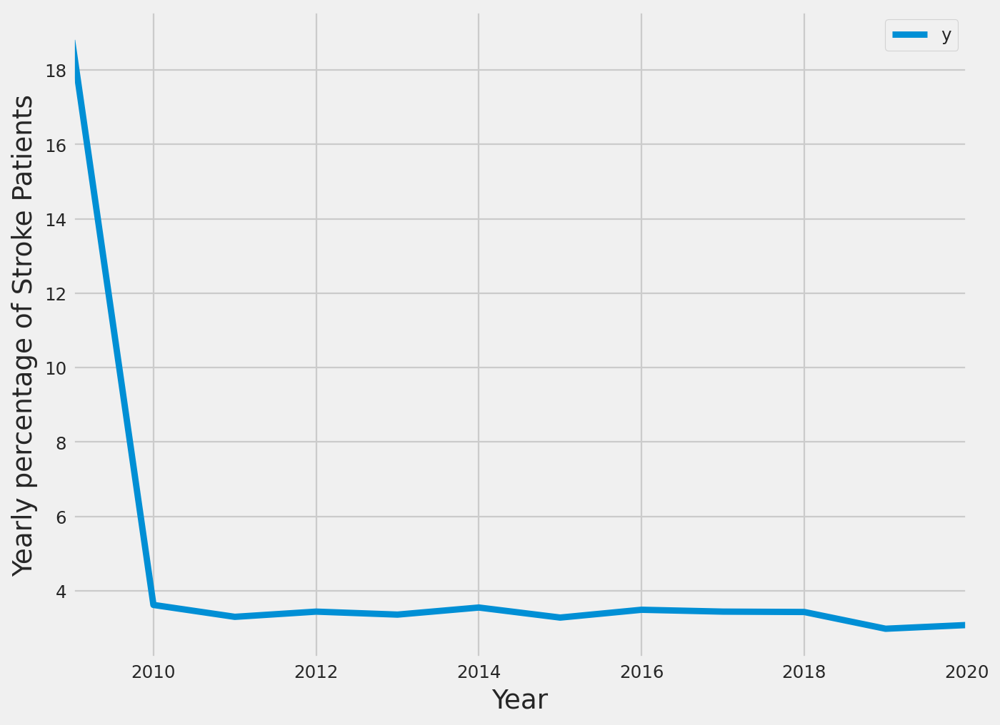

In [ ]:
ax = df.set_index('ds').plot(figsize=(9, 7))
ax.set_ylabel('Yearly percentage of Stroke Patients')
ax.set_xlabel('Year')

plt.show()

In [ ]:
# set the uncertainty interval to 95% (the Prophet default is 80%)
my_model = Prophet(interval_width=0.95)

In [ ]:
my_model.fit(df)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpvxcm8dyq/t1mh2vl0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpvxcm8dyq/9xhxkjms.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.8/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89035', 'data', 'file=/tmp/tmpvxcm8dyq/t1mh2vl0.json', 'init=/tmp/tmpvxcm8dyq/9xhxkjms.json', 'output', 'file=/tmp/tmpvxcm8dyq/prophet_modelsjlrsump/prophet_model-20221212080259.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
08:02:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:02:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cm

In [ ]:
f = m.make_future_dataframe(periods=96, freq='MS')
f.head()

,ds
0,2009-01-01
1,2010-01-01
2,2011-01-01
3,2012-01-01
4,2013-01-01


In [ ]:
fore = my_model.predict(f)
fore[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,2009-01-01,9.110095,2.107338,15.743025
1,2010-01-01,7.439767,1.073526,14.441727
2,2011-01-01,5.846322,-1.156169,13.083217
3,2012-01-01,4.331078,-2.466542,11.457511
4,2013-01-01,7.090194,0.474411,14.000055


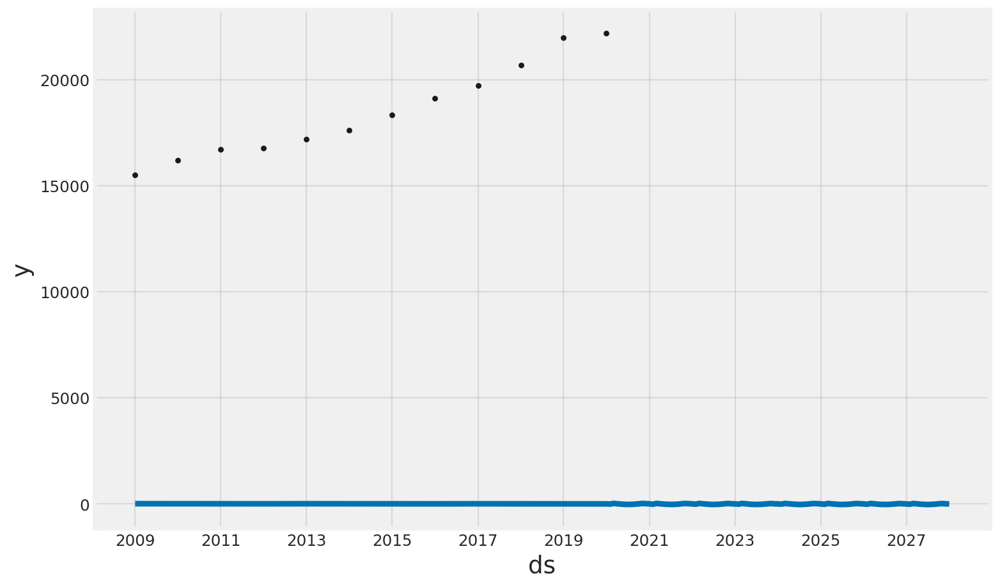

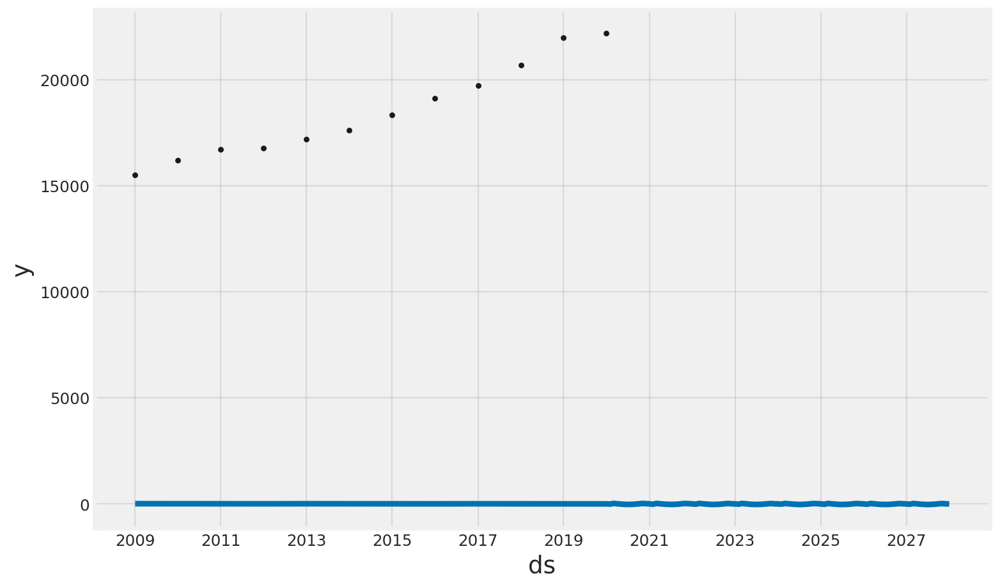

In [ ]:
m.plot(fore, uncertainty=True)

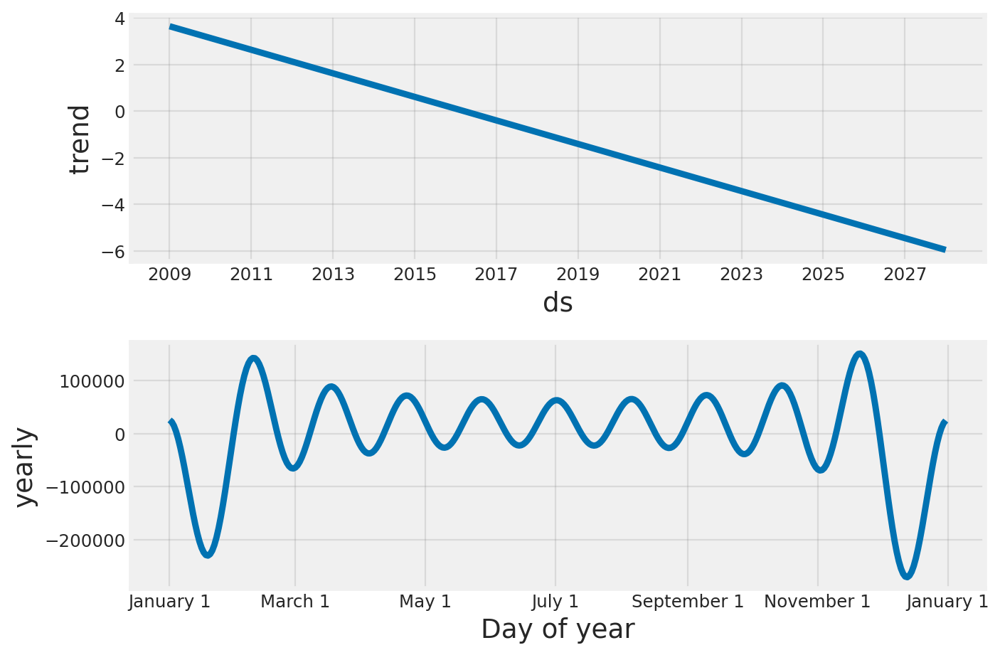

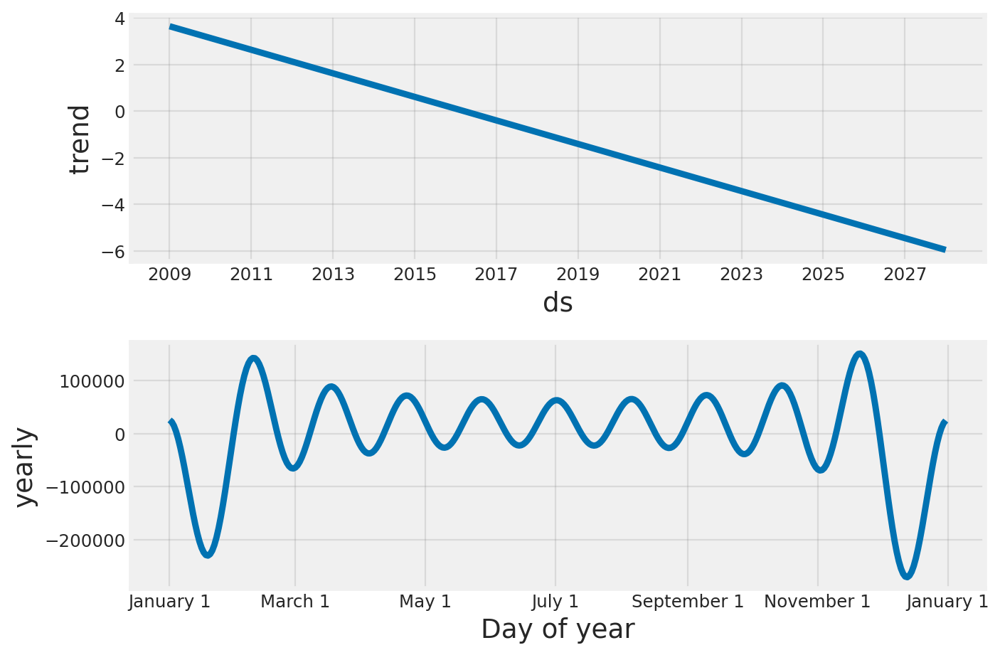

In [ ]:
m.plot_components(fore)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12 entries, 0 to 11
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   ds      12 non-null     datetime64[ns]
 1   y       12 non-null     float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 320.0 bytes


In [ ]:
#Splitting the data
train_size = int(0.85 * len(df))
test_size = len(df) - train_size

univariate_df = df.copy()

train = univariate_df.iloc[:train_size, :]

x_train, y_train = pd.DataFrame(univariate_df.iloc[:train_size, 0]), pd.DataFrame(univariate_df.iloc[:train_size, 1])
x_valid, y_valid = pd.DataFrame(univariate_df.iloc[train_size:, 0]), pd.DataFrame(univariate_df.iloc[train_size:, 1])

print(len(train), len(x_valid))

10 2


In [ ]:
import math

In [ ]:
# Train the model
model = Prophet()
model.fit(train)


# Predict on valid set
y_pred = model.predict(x_valid)

# Calcuate metrics
score_mae = mean_absolute_error(y_valid, y_pred.tail(test_size)['yhat'])
score_rmse = math.sqrt(mean_squared_error(y_valid, y_pred.tail(test_size)['yhat']))

print('RMSE: {}'.format(score_rmse))

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpvxcm8dyq/xlqrayec.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpvxcm8dyq/lgtzciho.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.8/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60914', 'data', 'file=/tmp/tmpvxcm8dyq/xlqrayec.json', 'init=/tmp/tmpvxcm8dyq/lgtzciho.json', 'output', 'file=/tmp/tmpvxcm8dyq/prophet_modeldfcz12z7/prophet_model-20221212084840.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
08:48:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:48:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cm

RMSE: 4.758379474516852


In [ ]:
from statsmodels.graphics.tsaplots import plot_predict
from statsmodels.tsa.arima.model import ARIMA

AttributeError: ignored

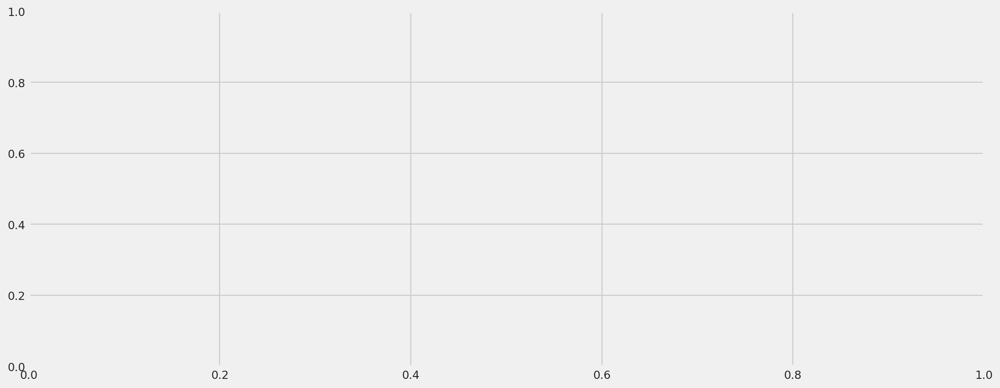

In [ ]:

# Plot the forecast
f, ax = plt.subplots(1)
f.set_figheight(6)
f.set_figwidth(15)

#model.plot_predict(y_pred, ax=ax)
plot_predict(y_pred, ax=ax)
sb.lineplot(x=x_valid['ds'], y=y_valid['y'], ax=ax, color='orange', label='Ground truth') #navajowhite

ax.set_title(f'Prediction \n MAE: {score_mae:.2f}, RMSE: {score_rmse:.2f}', fontsize=14)
ax.set_xlabel(xlabel='Date', fontsize=14)
ax.set_ylabel(ylabel='Depth to Groundwater', fontsize=14)

plt.show()

In [ ]:
#Error metrics
mean_squared_error(y_true=pjme_test['Percentage_of_stroke'],
                   y_pred=pjme_test_fcst['yhat'])

# Predict on training set with model
pjme_test_fcst = model.predict(df=pjme_test.reset_index() \
                                   .rename(columns={'Datetime':'ds'}))

NameError: ignored

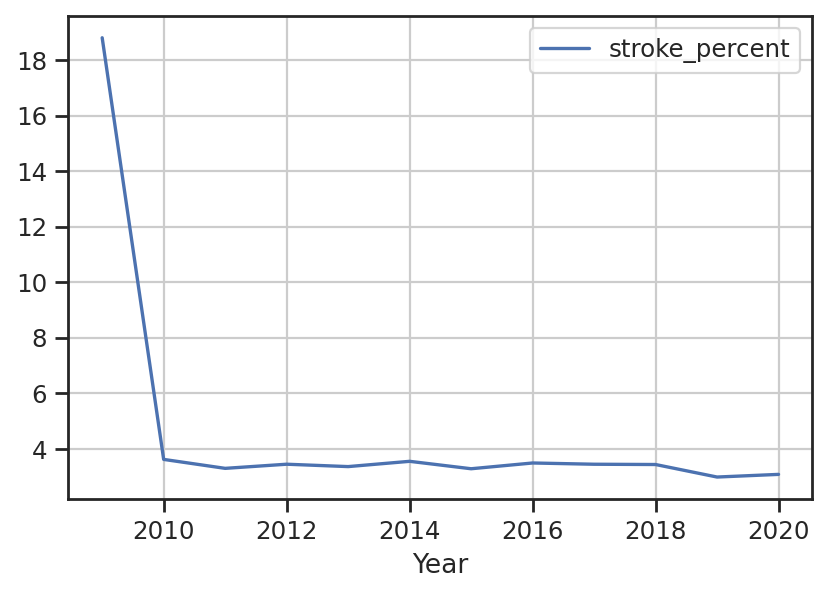

In [ ]:
a.plot(grid ='on')

In [ ]:
b = pd.DataFrame(chd.groupby('Year')['Count'].sum())
b.reset_index(inplace = True)
color_choice = sb.color_palette()[0]
sb.barplot(x='Year', y='Count', data=b, color = color_choice)
plt.xticks(rotation =90)
plt.xlabel('NHS Regions in Mid Essex')
plt.ylabel('Percentage of patients with Coronary Heart Disease');

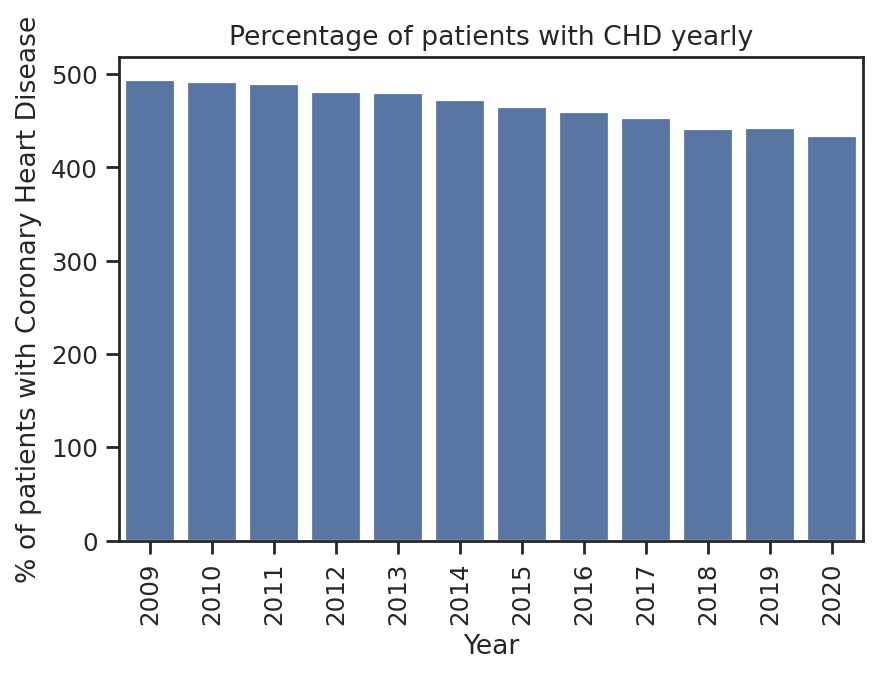

In [ ]:
b = pd.DataFrame(chd.groupby('Year')['percentage_value'].sum())
b.reset_index(inplace = True)
color_choice = sb.color_palette()[0]
sb.barplot(x='Year', y='percentage_value', data=b, color = color_choice)
plt.xticks(rotation =90)
plt.xlabel('Year')
plt.ylabel('% of patients with Coronary Heart Disease')
plt.title('Percentage of patients with CHD yearly');


In [ ]:
#Details on the Gp who has the highest proportion of chd patients 
df_merge.loc[df_merge['stroke_patients'].idxmax()]

In [ ]:
df = data.groupby(['pulse', 'diet']).count()['time']
print(df)
 
# plot the result
df.plot()
plt.xticks(rotation=45)
plt.show()

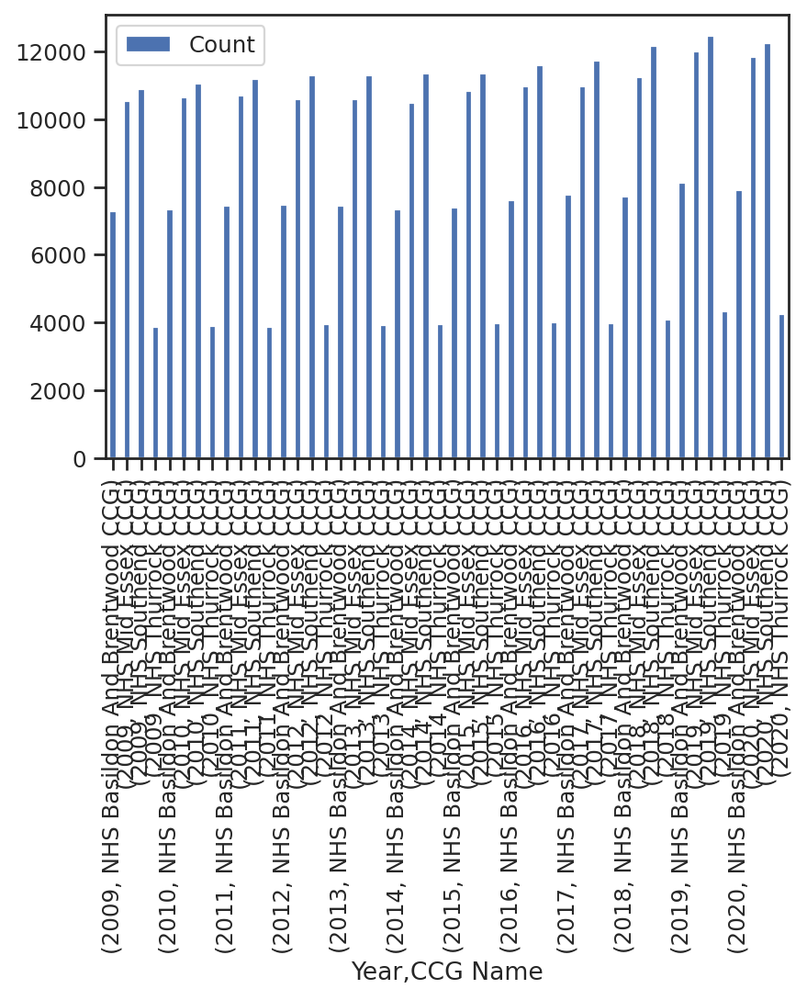

In [ ]:
#Sum of chd patients over the years
yearly_sum = pd.DataFrame(chd.groupby(['Year', 'CCG Name'])['Count'].sum())
yearly_sum
figsize=(50, 30)
yearly_sum.plot(kind = 'bar')
plt.xticks(rotation=90)
plt.show()

In [ ]:
yearly_sum = pd.DataFrame(chd.groupby(['Year', 'CCG Name'])['Count'].sum())
yearly_sum

Count
Year CCG Name                               
2009 NHS Basildon And Brentwood CCG   7297.0
     NHS Mid Essex CCG               10548.0
     NHS Southend CCG                10890.0
     NHS Thurrock CCG                 3864.0
2010 NHS Basildon And Brentwood CCG   7345.0
     NHS Mid Essex CCG               10654.0
     NHS Southend CCG                11062.0
     NHS Thurrock CCG                 3885.0
2011 NHS Basildon And Brentwood CCG   7458.0
     NHS Mid Essex CCG               10696.0
     NHS Southend CCG                11194.0
     NHS Thurrock CCG                 3880.0
2012 NHS Basildon And Brentwood CCG   7467.0
     NHS Mid Essex CCG               10592.0
     NHS Southend CCG                11301.0
     NHS Thurrock CCG                 3940.0
2013 NHS Basildon And Brentwood CCG   7446.0
     NHS Mid Essex CCG               10594.0
     NHS Southend CCG                11287.0
     NHS Thurrock CCG                 3937.0
2014 NHS Basildon And Brentwood CCG   7351.0
     NHS Mid Essex CCG               10483.0
     NHS Southend CCG                11355.0
     NHS Thurrock CCG                 3955.0
2015 NHS Basildon And Brentwood CCG   7400.0
     NHS Mid Essex CCG               10836.0
     NHS Southend CCG                11340.0
     NHS Thurrock CCG                 3982.0
2016 NHS Basildon And Brentwood CCG   7610.0
     NHS Mid Essex CCG               10981.0
     NHS Southend CCG                11598.0
     NHS Thurrock CCG                 3999.0
2017 NHS Basildon And Brentwood CCG   7777.0
     NHS Mid Essex CCG               10970.0
     NHS Southend CCG                11743.0
     NHS Thurrock CCG                 3987.0
2018 NHS Basildon And Brentwood CCG   7713.0
     NHS Mid Essex CCG               11240.0
     NHS Southend CCG                12176.0
     NHS Thurrock CCG                 4098.0
2019 NHS Basildon And Brentwood CCG   8132.0
     NHS Mid Essex CCG               12012.0
     NHS Southend CCG                12474.0
     NHS Thurrock CCG                 4334.0
2020 NHS Basildon And Brentwood CCG   7916.0
     NHS Mid Essex CCG               11843.0
     NHS Southend CCG                12249.0
     NHS Thurrock CCG                 4252.0

In [ ]:
#Sum of chd patients over the years
year = pd.DataFrame(chd.groupby(['Year', 'CCG Name'])['percentage_value'].aggregate('max'))
year

percentage_value
Year CCG Name                                        
2009 NHS Basildon And Brentwood CCG          5.218174
     NHS Mid Essex CCG                      13.675214
     NHS Southend CCG                        5.822416
     NHS Thurrock CCG                        4.013664
2010 NHS Basildon And Brentwood CCG          5.210084
     NHS Mid Essex CCG                       5.549598
     NHS Southend CCG                        5.706052
     NHS Thurrock CCG                        4.143862
2011 NHS Basildon And Brentwood CCG          5.406722
     NHS Mid Essex CCG                       5.384006
     NHS Southend CCG                        5.575326
     NHS Thurrock CCG                        4.309392
2012 NHS Basildon And Brentwood CCG          5.295056
     NHS Mid Essex CCG                       5.045752
     NHS Southend CCG                        5.330287
     NHS Thurrock CCG                        4.614653
2013 NHS Basildon And Brentwood CCG          5.206177
     NHS Mid Essex CCG                       4.730618
     NHS Southend CCG                        5.241772
     NHS Thurrock CCG                        5.501166
2014 NHS Basildon And Brentwood CCG          5.254185
     NHS Mid Essex CCG                       4.443867
     NHS Southend CCG                        4.715248
     NHS Thurrock CCG                        5.251921
2015 NHS Basildon And Brentwood CCG          4.853833
     NHS Mid Essex CCG                       4.495372
     NHS Southend CCG                        4.632752
     NHS Thurrock CCG                        4.723347
2016 NHS Basildon And Brentwood CCG          4.848406
     NHS Mid Essex CCG                       4.298203
     NHS Southend CCG                        4.597216
     NHS Thurrock CCG                        4.144219
2017 NHS Basildon And Brentwood CCG          4.703766
     NHS Mid Essex CCG                       4.078265
     NHS Southend CCG                        4.589161
     NHS Thurrock CCG                        3.973510
2018 NHS Basildon And Brentwood CCG          4.864037
     NHS Mid Essex CCG                       4.145613
     NHS Southend CCG                        4.637009
     NHS Thurrock CCG                        3.796554
2019 NHS Basildon And Brentwood CCG          4.576557
     NHS Mid Essex CCG                       3.994066
     NHS Southend CCG                        5.039863
     NHS Thurrock CCG                        3.682662
2020 NHS Basildon And Brentwood CCG          4.270557
     NHS Mid Essex CCG                       3.886882
     NHS Southend CCG                        4.733045
     NHS Thurrock CCG                        3.716941

In [ ]:

a = chd.groupby(['Year', 'CCG Name'])['percentage_value'].aggregate('max')
a

Year  CCG Name                      
2009  NHS Basildon And Brentwood CCG     5.218174
      NHS Mid Essex CCG                 13.675214
      NHS Southend CCG                   5.822416
      NHS Thurrock CCG                   4.013664
2010  NHS Basildon And Brentwood CCG     5.210084
      NHS Mid Essex CCG                  5.549598
      NHS Southend CCG                   5.706052
      NHS Thurrock CCG                   4.143862
2011  NHS Basildon And Brentwood CCG     5.406722
      NHS Mid Essex CCG                  5.384006
      NHS Southend CCG                   5.575326
      NHS Thurrock CCG                   4.309392
2012  NHS Basildon And Brentwood CCG     5.295056
      NHS Mid Essex CCG                  5.045752
      NHS Southend CCG                   5.330287
      NHS Thurrock CCG                   4.614653
2013  NHS Basildon And Brentwood CCG     5.206177
      NHS Mid Essex CCG                  4.730618
      NHS Southend CCG                   5.241772
      NHS Thu